# Deep Convolutional GANs
 The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
#!mkdir data

## Getting the data



In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

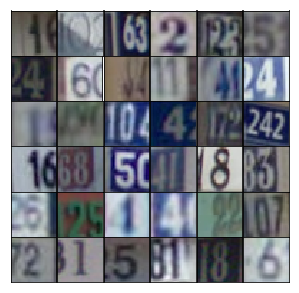

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(self.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs


In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator



![DCGAN Generator](assets/dcgan.png)



In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss


In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers


In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model


In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters
[the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf)

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.7881... Generator Loss: 0.3537
Epoch 1/25... Discriminator Loss: 0.4665... Generator Loss: 1.5879
Epoch 1/25... Discriminator Loss: 0.1370... Generator Loss: 2.9356
Epoch 1/25... Discriminator Loss: 0.1327... Generator Loss: 2.6447
Epoch 1/25... Discriminator Loss: 0.1459... Generator Loss: 2.8250
Epoch 1/25... Discriminator Loss: 0.1193... Generator Loss: 2.5568
Epoch 1/25... Discriminator Loss: 0.0813... Generator Loss: 4.3587
Epoch 1/25... Discriminator Loss: 0.1190... Generator Loss: 3.1242
Epoch 1/25... Discriminator Loss: 0.1245... Generator Loss: 2.7331
Epoch 1/25... Discriminator Loss: 0.0813... Generator Loss: 3.5405


C:\Anaconda3\envs\tensorflow\lib\site-packages\matplotlib\axes\_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


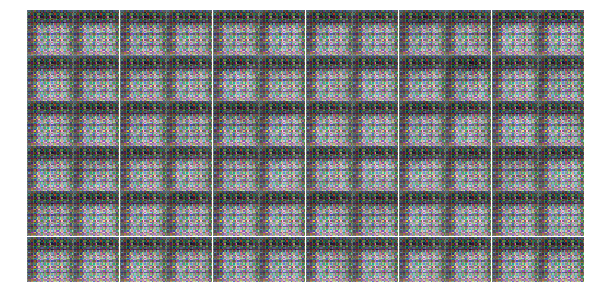

Epoch 1/25... Discriminator Loss: 0.1227... Generator Loss: 3.3626
Epoch 1/25... Discriminator Loss: 0.1095... Generator Loss: 3.4310
Epoch 1/25... Discriminator Loss: 0.1698... Generator Loss: 3.1841
Epoch 1/25... Discriminator Loss: 1.3554... Generator Loss: 0.7970
Epoch 1/25... Discriminator Loss: 1.3959... Generator Loss: 0.5541
Epoch 1/25... Discriminator Loss: 0.6185... Generator Loss: 1.1360
Epoch 1/25... Discriminator Loss: 0.3225... Generator Loss: 2.9152
Epoch 1/25... Discriminator Loss: 0.3772... Generator Loss: 1.8769
Epoch 1/25... Discriminator Loss: 0.8629... Generator Loss: 2.9826
Epoch 1/25... Discriminator Loss: 0.2517... Generator Loss: 4.1906


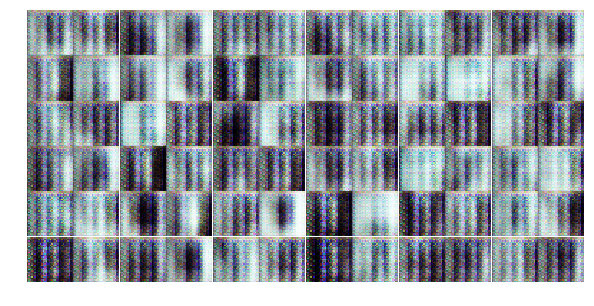

Epoch 1/25... Discriminator Loss: 1.5322... Generator Loss: 6.1429
Epoch 1/25... Discriminator Loss: 0.4520... Generator Loss: 2.1869
Epoch 1/25... Discriminator Loss: 0.5251... Generator Loss: 1.4670
Epoch 1/25... Discriminator Loss: 1.7361... Generator Loss: 0.4490
Epoch 1/25... Discriminator Loss: 1.0240... Generator Loss: 0.5841
Epoch 1/25... Discriminator Loss: 0.9070... Generator Loss: 0.7367
Epoch 1/25... Discriminator Loss: 0.4661... Generator Loss: 1.9372
Epoch 1/25... Discriminator Loss: 1.6413... Generator Loss: 3.3903
Epoch 1/25... Discriminator Loss: 1.0256... Generator Loss: 1.6311
Epoch 1/25... Discriminator Loss: 1.3949... Generator Loss: 1.5226


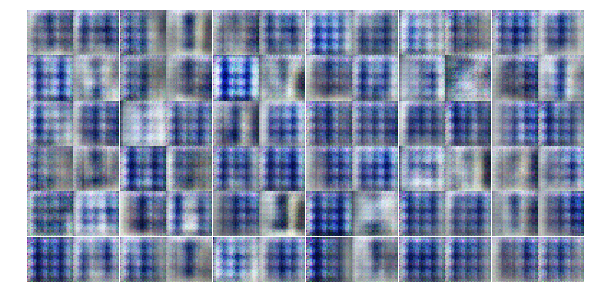

Epoch 1/25... Discriminator Loss: 1.0006... Generator Loss: 0.9469
Epoch 1/25... Discriminator Loss: 1.2681... Generator Loss: 0.8207
Epoch 1/25... Discriminator Loss: 1.3609... Generator Loss: 0.8168
Epoch 1/25... Discriminator Loss: 1.1929... Generator Loss: 0.8990
Epoch 1/25... Discriminator Loss: 0.9703... Generator Loss: 1.1302
Epoch 1/25... Discriminator Loss: 0.6794... Generator Loss: 1.5905
Epoch 1/25... Discriminator Loss: 0.4396... Generator Loss: 1.6665
Epoch 1/25... Discriminator Loss: 0.3189... Generator Loss: 2.5806
Epoch 1/25... Discriminator Loss: 0.4267... Generator Loss: 1.8308
Epoch 1/25... Discriminator Loss: 0.7911... Generator Loss: 1.8053


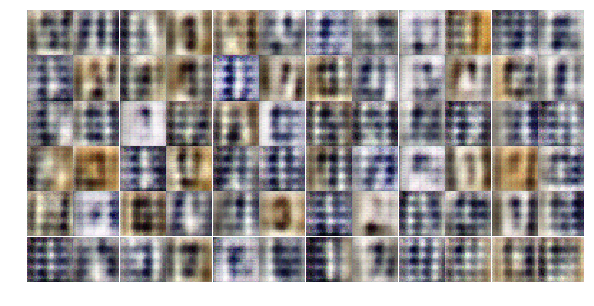

Epoch 1/25... Discriminator Loss: 0.5312... Generator Loss: 1.7887
Epoch 1/25... Discriminator Loss: 0.5501... Generator Loss: 1.3184
Epoch 1/25... Discriminator Loss: 0.6623... Generator Loss: 1.4666
Epoch 1/25... Discriminator Loss: 0.4930... Generator Loss: 2.6731
Epoch 1/25... Discriminator Loss: 0.9021... Generator Loss: 1.4226
Epoch 1/25... Discriminator Loss: 0.8086... Generator Loss: 1.6016
Epoch 1/25... Discriminator Loss: 0.9905... Generator Loss: 0.8994
Epoch 1/25... Discriminator Loss: 0.9717... Generator Loss: 1.2970
Epoch 1/25... Discriminator Loss: 0.9571... Generator Loss: 0.7800
Epoch 1/25... Discriminator Loss: 0.4008... Generator Loss: 2.1954


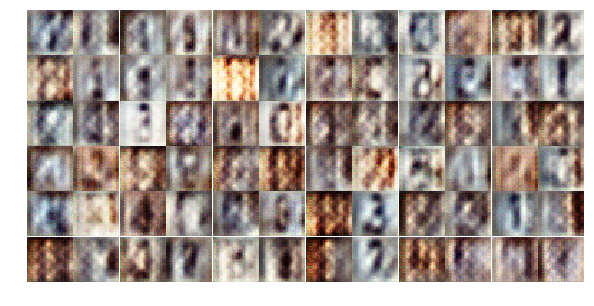

Epoch 1/25... Discriminator Loss: 0.6908... Generator Loss: 1.5139
Epoch 1/25... Discriminator Loss: 1.2365... Generator Loss: 0.5472
Epoch 1/25... Discriminator Loss: 0.7032... Generator Loss: 1.7940
Epoch 1/25... Discriminator Loss: 1.0450... Generator Loss: 0.7482
Epoch 1/25... Discriminator Loss: 0.6161... Generator Loss: 1.6074
Epoch 1/25... Discriminator Loss: 1.1295... Generator Loss: 0.8114
Epoch 1/25... Discriminator Loss: 0.6927... Generator Loss: 1.6353
Epoch 2/25... Discriminator Loss: 0.9030... Generator Loss: 1.4322
Epoch 2/25... Discriminator Loss: 0.6932... Generator Loss: 1.5397
Epoch 2/25... Discriminator Loss: 0.8502... Generator Loss: 1.3787


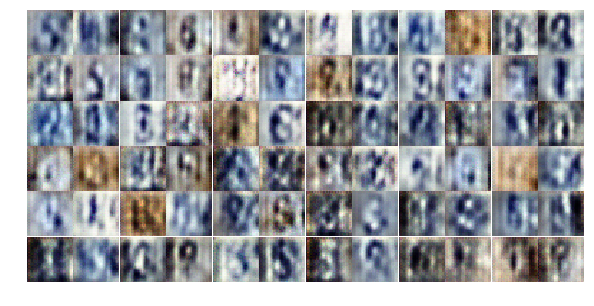

Epoch 2/25... Discriminator Loss: 1.0551... Generator Loss: 0.9864
Epoch 2/25... Discriminator Loss: 1.2248... Generator Loss: 0.7965
Epoch 2/25... Discriminator Loss: 0.9054... Generator Loss: 0.9154
Epoch 2/25... Discriminator Loss: 0.6320... Generator Loss: 1.6947
Epoch 2/25... Discriminator Loss: 0.8386... Generator Loss: 0.8308
Epoch 2/25... Discriminator Loss: 0.4260... Generator Loss: 1.9189
Epoch 2/25... Discriminator Loss: 0.9939... Generator Loss: 1.0711
Epoch 2/25... Discriminator Loss: 0.9320... Generator Loss: 1.8734
Epoch 2/25... Discriminator Loss: 0.5821... Generator Loss: 1.5047
Epoch 2/25... Discriminator Loss: 0.8472... Generator Loss: 1.2581


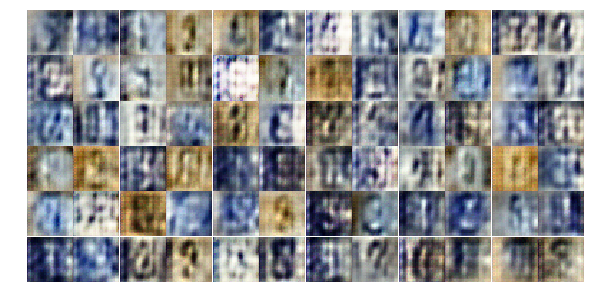

Epoch 2/25... Discriminator Loss: 0.8685... Generator Loss: 1.0975
Epoch 2/25... Discriminator Loss: 0.8814... Generator Loss: 1.4104
Epoch 2/25... Discriminator Loss: 1.3276... Generator Loss: 0.9334
Epoch 2/25... Discriminator Loss: 0.7136... Generator Loss: 1.1730
Epoch 2/25... Discriminator Loss: 0.8797... Generator Loss: 1.5227
Epoch 2/25... Discriminator Loss: 0.9399... Generator Loss: 1.2801
Epoch 2/25... Discriminator Loss: 1.0080... Generator Loss: 0.9639
Epoch 2/25... Discriminator Loss: 1.2260... Generator Loss: 0.5777
Epoch 2/25... Discriminator Loss: 1.0401... Generator Loss: 0.9992
Epoch 2/25... Discriminator Loss: 1.1061... Generator Loss: 0.6061


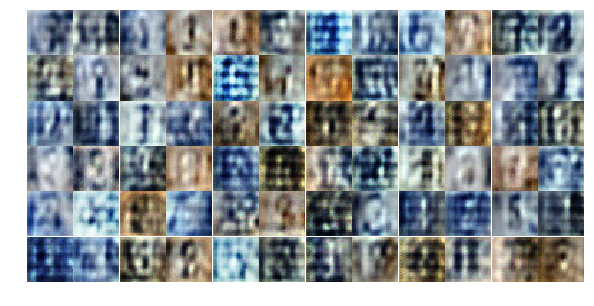

Epoch 2/25... Discriminator Loss: 1.0403... Generator Loss: 0.7118
Epoch 2/25... Discriminator Loss: 0.8349... Generator Loss: 1.2242
Epoch 2/25... Discriminator Loss: 0.8285... Generator Loss: 1.2934
Epoch 2/25... Discriminator Loss: 1.0564... Generator Loss: 0.7309
Epoch 2/25... Discriminator Loss: 1.2396... Generator Loss: 1.1444
Epoch 2/25... Discriminator Loss: 0.8956... Generator Loss: 1.2068
Epoch 2/25... Discriminator Loss: 1.2908... Generator Loss: 0.8409
Epoch 2/25... Discriminator Loss: 1.0599... Generator Loss: 0.7810
Epoch 2/25... Discriminator Loss: 1.1365... Generator Loss: 0.8022
Epoch 2/25... Discriminator Loss: 1.0683... Generator Loss: 1.1679


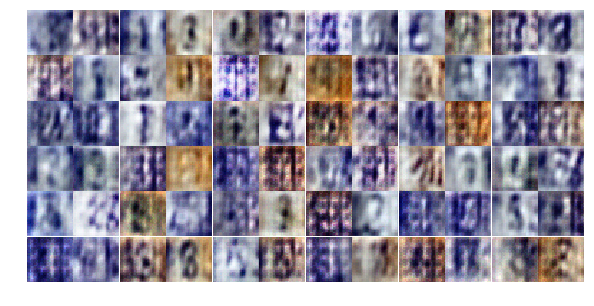

Epoch 2/25... Discriminator Loss: 1.2480... Generator Loss: 0.8107
Epoch 2/25... Discriminator Loss: 1.5193... Generator Loss: 0.3963
Epoch 2/25... Discriminator Loss: 1.1592... Generator Loss: 0.7421
Epoch 2/25... Discriminator Loss: 0.9216... Generator Loss: 1.1162
Epoch 2/25... Discriminator Loss: 0.9148... Generator Loss: 1.2028
Epoch 2/25... Discriminator Loss: 1.2851... Generator Loss: 0.5655
Epoch 2/25... Discriminator Loss: 0.9619... Generator Loss: 1.0579
Epoch 2/25... Discriminator Loss: 0.8588... Generator Loss: 1.2878
Epoch 2/25... Discriminator Loss: 1.1153... Generator Loss: 0.6842
Epoch 2/25... Discriminator Loss: 1.4154... Generator Loss: 0.4743


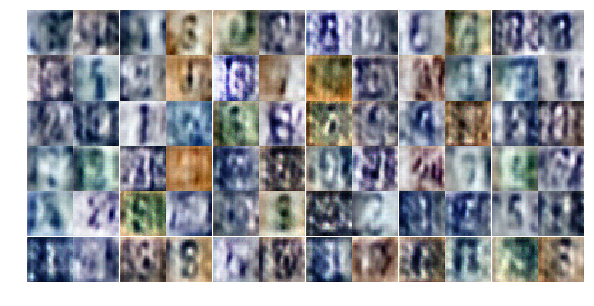

Epoch 2/25... Discriminator Loss: 0.7409... Generator Loss: 2.3627
Epoch 2/25... Discriminator Loss: 1.3203... Generator Loss: 0.8236
Epoch 2/25... Discriminator Loss: 0.8934... Generator Loss: 1.6971
Epoch 2/25... Discriminator Loss: 1.1060... Generator Loss: 1.0587
Epoch 2/25... Discriminator Loss: 0.9786... Generator Loss: 1.2571
Epoch 2/25... Discriminator Loss: 1.0107... Generator Loss: 1.4145
Epoch 2/25... Discriminator Loss: 0.9386... Generator Loss: 1.3204
Epoch 2/25... Discriminator Loss: 0.9248... Generator Loss: 1.0361
Epoch 2/25... Discriminator Loss: 0.7157... Generator Loss: 1.8242
Epoch 2/25... Discriminator Loss: 1.0696... Generator Loss: 0.9637


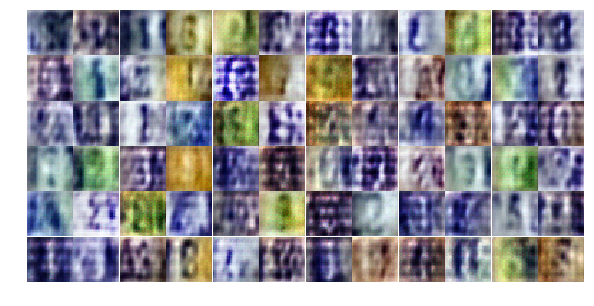

Epoch 2/25... Discriminator Loss: 1.0871... Generator Loss: 0.8800
Epoch 2/25... Discriminator Loss: 0.8168... Generator Loss: 1.7916
Epoch 2/25... Discriminator Loss: 1.0691... Generator Loss: 0.8949
Epoch 2/25... Discriminator Loss: 0.8783... Generator Loss: 0.9435
Epoch 3/25... Discriminator Loss: 0.6136... Generator Loss: 1.9427
Epoch 3/25... Discriminator Loss: 0.8422... Generator Loss: 1.2997
Epoch 3/25... Discriminator Loss: 0.5723... Generator Loss: 1.9668
Epoch 3/25... Discriminator Loss: 0.4844... Generator Loss: 1.8358
Epoch 3/25... Discriminator Loss: 0.6030... Generator Loss: 1.7553
Epoch 3/25... Discriminator Loss: 0.8932... Generator Loss: 0.9055


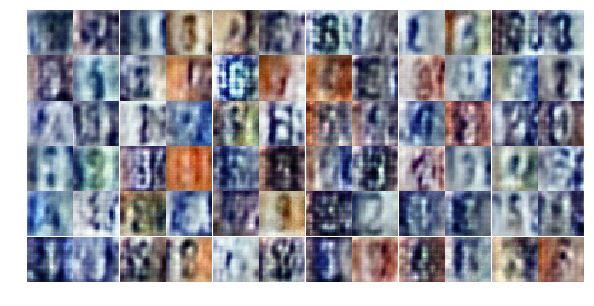

Epoch 3/25... Discriminator Loss: 0.5883... Generator Loss: 2.0680
Epoch 3/25... Discriminator Loss: 0.4868... Generator Loss: 2.1185
Epoch 3/25... Discriminator Loss: 0.8314... Generator Loss: 0.9506
Epoch 3/25... Discriminator Loss: 0.5685... Generator Loss: 2.1703
Epoch 3/25... Discriminator Loss: 0.8791... Generator Loss: 2.4203
Epoch 3/25... Discriminator Loss: 0.8925... Generator Loss: 0.9522
Epoch 3/25... Discriminator Loss: 0.8760... Generator Loss: 0.9147
Epoch 3/25... Discriminator Loss: 0.6717... Generator Loss: 1.7116
Epoch 3/25... Discriminator Loss: 1.0318... Generator Loss: 0.5851
Epoch 3/25... Discriminator Loss: 0.6295... Generator Loss: 1.2477


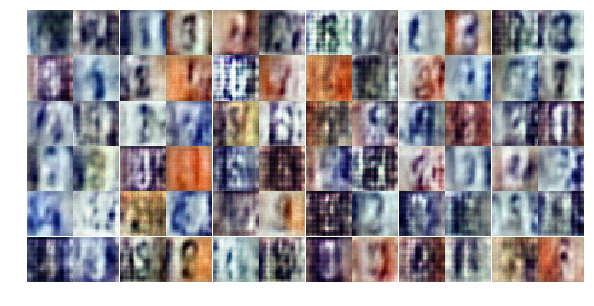

Epoch 3/25... Discriminator Loss: 0.9849... Generator Loss: 1.8219
Epoch 3/25... Discriminator Loss: 0.6429... Generator Loss: 1.3428
Epoch 3/25... Discriminator Loss: 0.9449... Generator Loss: 2.0861
Epoch 3/25... Discriminator Loss: 0.6854... Generator Loss: 2.1692
Epoch 3/25... Discriminator Loss: 0.7073... Generator Loss: 2.3061
Epoch 3/25... Discriminator Loss: 0.6230... Generator Loss: 1.6088
Epoch 3/25... Discriminator Loss: 1.3976... Generator Loss: 0.3503
Epoch 3/25... Discriminator Loss: 0.8617... Generator Loss: 1.4066
Epoch 3/25... Discriminator Loss: 0.4132... Generator Loss: 2.5846
Epoch 3/25... Discriminator Loss: 0.7006... Generator Loss: 1.2599


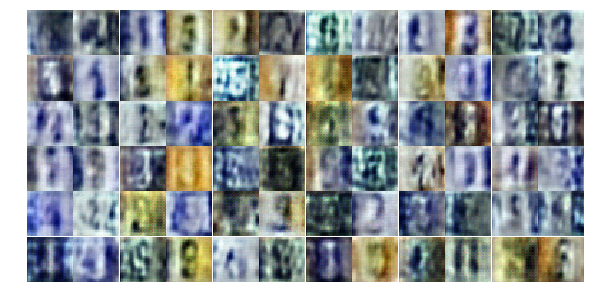

Epoch 3/25... Discriminator Loss: 0.7867... Generator Loss: 1.0438
Epoch 3/25... Discriminator Loss: 0.7493... Generator Loss: 2.0102
Epoch 3/25... Discriminator Loss: 0.5232... Generator Loss: 1.8625
Epoch 3/25... Discriminator Loss: 0.8031... Generator Loss: 1.3864
Epoch 3/25... Discriminator Loss: 0.4517... Generator Loss: 1.8351
Epoch 3/25... Discriminator Loss: 0.4841... Generator Loss: 1.3046
Epoch 3/25... Discriminator Loss: 0.8556... Generator Loss: 1.6714
Epoch 3/25... Discriminator Loss: 0.4309... Generator Loss: 3.2275
Epoch 3/25... Discriminator Loss: 1.0530... Generator Loss: 0.6743
Epoch 3/25... Discriminator Loss: 1.2316... Generator Loss: 0.5462


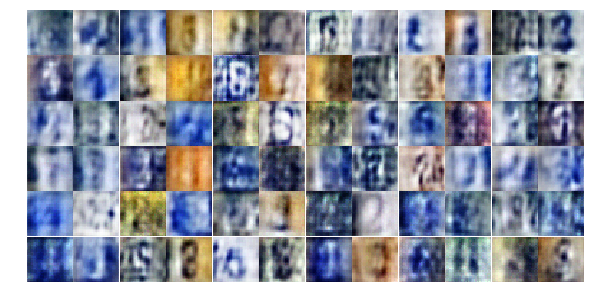

Epoch 3/25... Discriminator Loss: 0.6740... Generator Loss: 2.2080
Epoch 3/25... Discriminator Loss: 0.4124... Generator Loss: 3.5880
Epoch 3/25... Discriminator Loss: 0.8565... Generator Loss: 0.7359
Epoch 3/25... Discriminator Loss: 0.3458... Generator Loss: 2.3189
Epoch 3/25... Discriminator Loss: 0.5063... Generator Loss: 3.1763
Epoch 3/25... Discriminator Loss: 0.7967... Generator Loss: 2.1930
Epoch 3/25... Discriminator Loss: 1.3569... Generator Loss: 0.5095
Epoch 3/25... Discriminator Loss: 1.5015... Generator Loss: 0.3920
Epoch 3/25... Discriminator Loss: 0.4679... Generator Loss: 2.4003
Epoch 3/25... Discriminator Loss: 1.0005... Generator Loss: 0.7859


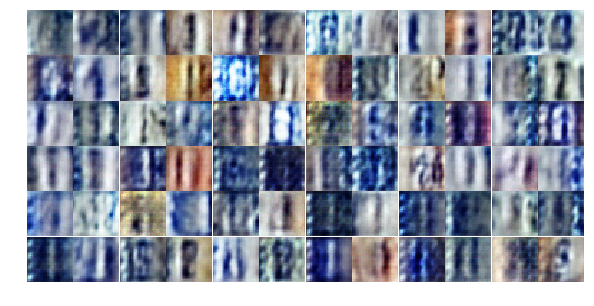

Epoch 3/25... Discriminator Loss: 0.7740... Generator Loss: 1.0366
Epoch 3/25... Discriminator Loss: 1.2770... Generator Loss: 0.4752
Epoch 3/25... Discriminator Loss: 0.8537... Generator Loss: 0.9317
Epoch 3/25... Discriminator Loss: 0.6279... Generator Loss: 1.6513
Epoch 3/25... Discriminator Loss: 1.0366... Generator Loss: 2.1752
Epoch 3/25... Discriminator Loss: 0.4830... Generator Loss: 1.9535
Epoch 3/25... Discriminator Loss: 0.6743... Generator Loss: 1.2759
Epoch 3/25... Discriminator Loss: 0.5739... Generator Loss: 1.5148
Epoch 3/25... Discriminator Loss: 0.3912... Generator Loss: 1.7916
Epoch 3/25... Discriminator Loss: 1.2031... Generator Loss: 0.4815


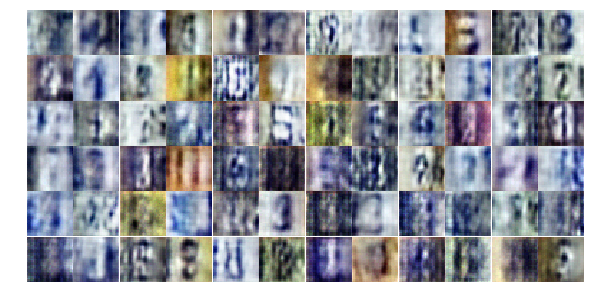

Epoch 3/25... Discriminator Loss: 1.1695... Generator Loss: 0.8830
Epoch 4/25... Discriminator Loss: 1.3375... Generator Loss: 0.4478
Epoch 4/25... Discriminator Loss: 1.0412... Generator Loss: 1.2411
Epoch 4/25... Discriminator Loss: 0.6163... Generator Loss: 1.4815
Epoch 4/25... Discriminator Loss: 1.2216... Generator Loss: 0.5038
Epoch 4/25... Discriminator Loss: 0.4360... Generator Loss: 1.7680
Epoch 4/25... Discriminator Loss: 0.3772... Generator Loss: 1.6619
Epoch 4/25... Discriminator Loss: 0.5671... Generator Loss: 1.9201
Epoch 4/25... Discriminator Loss: 0.5685... Generator Loss: 1.3515
Epoch 4/25... Discriminator Loss: 0.3071... Generator Loss: 2.8416


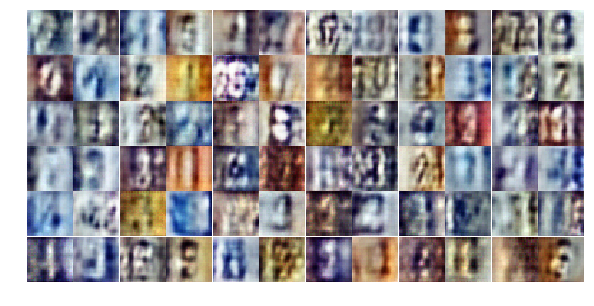

Epoch 4/25... Discriminator Loss: 0.3352... Generator Loss: 2.2643
Epoch 4/25... Discriminator Loss: 0.5190... Generator Loss: 1.5881
Epoch 4/25... Discriminator Loss: 1.3601... Generator Loss: 0.6414
Epoch 4/25... Discriminator Loss: 0.5776... Generator Loss: 1.3969
Epoch 4/25... Discriminator Loss: 0.8171... Generator Loss: 1.4958
Epoch 4/25... Discriminator Loss: 1.9473... Generator Loss: 4.3983
Epoch 4/25... Discriminator Loss: 0.9314... Generator Loss: 0.7638
Epoch 4/25... Discriminator Loss: 0.6789... Generator Loss: 1.0226
Epoch 4/25... Discriminator Loss: 0.6244... Generator Loss: 1.4033
Epoch 4/25... Discriminator Loss: 0.6031... Generator Loss: 1.3136


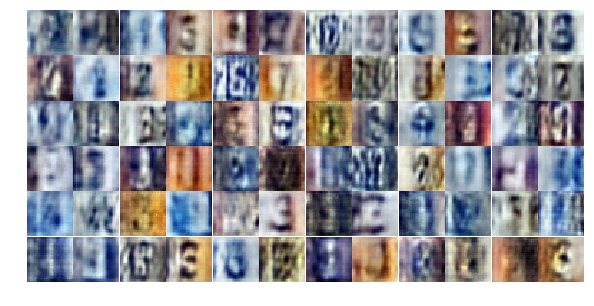

Epoch 4/25... Discriminator Loss: 0.3332... Generator Loss: 2.0244
Epoch 4/25... Discriminator Loss: 0.6010... Generator Loss: 2.5289
Epoch 4/25... Discriminator Loss: 0.6997... Generator Loss: 1.0603
Epoch 4/25... Discriminator Loss: 0.9278... Generator Loss: 0.8652
Epoch 4/25... Discriminator Loss: 0.4333... Generator Loss: 1.7901
Epoch 4/25... Discriminator Loss: 0.7299... Generator Loss: 1.1885
Epoch 4/25... Discriminator Loss: 0.9706... Generator Loss: 0.7678
Epoch 4/25... Discriminator Loss: 1.5129... Generator Loss: 0.4093
Epoch 4/25... Discriminator Loss: 0.5226... Generator Loss: 1.6276
Epoch 4/25... Discriminator Loss: 0.5902... Generator Loss: 1.6666


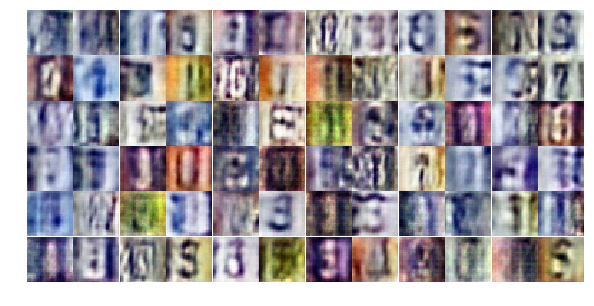

Epoch 4/25... Discriminator Loss: 0.5291... Generator Loss: 1.4784
Epoch 4/25... Discriminator Loss: 0.4738... Generator Loss: 1.8904
Epoch 4/25... Discriminator Loss: 0.6452... Generator Loss: 1.1600
Epoch 4/25... Discriminator Loss: 0.5535... Generator Loss: 1.4409
Epoch 4/25... Discriminator Loss: 0.6279... Generator Loss: 3.5458
Epoch 4/25... Discriminator Loss: 0.9411... Generator Loss: 1.3789
Epoch 4/25... Discriminator Loss: 0.7287... Generator Loss: 1.4896
Epoch 4/25... Discriminator Loss: 0.5056... Generator Loss: 1.4533
Epoch 4/25... Discriminator Loss: 1.2268... Generator Loss: 0.5485
Epoch 4/25... Discriminator Loss: 1.2398... Generator Loss: 0.4814


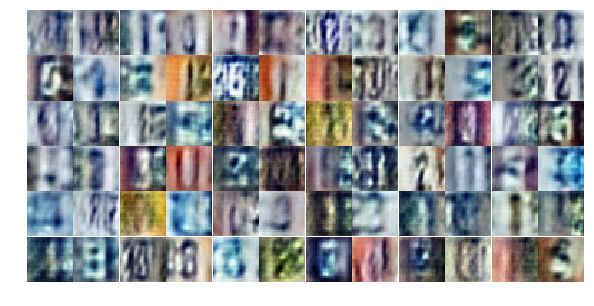

Epoch 4/25... Discriminator Loss: 0.6606... Generator Loss: 1.1081
Epoch 4/25... Discriminator Loss: 0.4227... Generator Loss: 1.6511
Epoch 4/25... Discriminator Loss: 0.9320... Generator Loss: 0.8986
Epoch 4/25... Discriminator Loss: 0.6824... Generator Loss: 1.1516
Epoch 4/25... Discriminator Loss: 0.6214... Generator Loss: 1.2484
Epoch 4/25... Discriminator Loss: 0.8610... Generator Loss: 0.9883
Epoch 4/25... Discriminator Loss: 1.5553... Generator Loss: 0.4749
Epoch 4/25... Discriminator Loss: 0.6181... Generator Loss: 1.6060
Epoch 4/25... Discriminator Loss: 0.5860... Generator Loss: 1.6019
Epoch 4/25... Discriminator Loss: 0.6174... Generator Loss: 1.8623


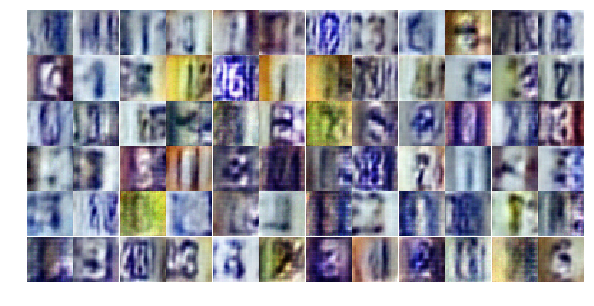

Epoch 4/25... Discriminator Loss: 0.4305... Generator Loss: 1.7743
Epoch 4/25... Discriminator Loss: 0.4478... Generator Loss: 1.8285
Epoch 4/25... Discriminator Loss: 0.6013... Generator Loss: 1.1809
Epoch 4/25... Discriminator Loss: 0.8452... Generator Loss: 0.7952
Epoch 4/25... Discriminator Loss: 0.6075... Generator Loss: 1.3165
Epoch 4/25... Discriminator Loss: 0.4463... Generator Loss: 1.9039
Epoch 4/25... Discriminator Loss: 0.4248... Generator Loss: 1.6278
Epoch 4/25... Discriminator Loss: 0.6115... Generator Loss: 1.3325
Epoch 4/25... Discriminator Loss: 0.6514... Generator Loss: 1.8222
Epoch 5/25... Discriminator Loss: 0.9391... Generator Loss: 0.6719


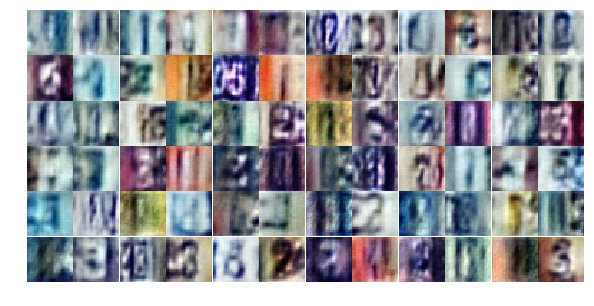

Epoch 5/25... Discriminator Loss: 0.5869... Generator Loss: 1.2331
Epoch 5/25... Discriminator Loss: 0.6754... Generator Loss: 0.9766
Epoch 5/25... Discriminator Loss: 1.1260... Generator Loss: 3.3671
Epoch 5/25... Discriminator Loss: 0.6751... Generator Loss: 1.0858
Epoch 5/25... Discriminator Loss: 0.4542... Generator Loss: 1.9188
Epoch 5/25... Discriminator Loss: 0.7564... Generator Loss: 0.9278
Epoch 5/25... Discriminator Loss: 0.4195... Generator Loss: 1.4620
Epoch 5/25... Discriminator Loss: 0.6249... Generator Loss: 1.1124
Epoch 5/25... Discriminator Loss: 0.7955... Generator Loss: 0.8132
Epoch 5/25... Discriminator Loss: 1.7687... Generator Loss: 0.2998


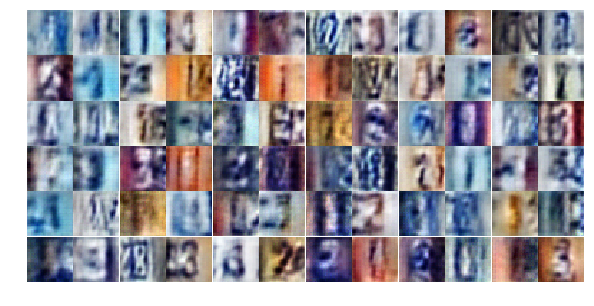

Epoch 5/25... Discriminator Loss: 0.8557... Generator Loss: 0.8678
Epoch 5/25... Discriminator Loss: 0.5788... Generator Loss: 1.6503
Epoch 5/25... Discriminator Loss: 1.1012... Generator Loss: 0.5799
Epoch 5/25... Discriminator Loss: 0.8290... Generator Loss: 0.9012
Epoch 5/25... Discriminator Loss: 0.4825... Generator Loss: 2.2999
Epoch 5/25... Discriminator Loss: 0.6048... Generator Loss: 1.3657
Epoch 5/25... Discriminator Loss: 0.3164... Generator Loss: 2.0514
Epoch 5/25... Discriminator Loss: 0.3971... Generator Loss: 1.9756
Epoch 5/25... Discriminator Loss: 0.4796... Generator Loss: 2.2006
Epoch 5/25... Discriminator Loss: 0.4612... Generator Loss: 1.6573


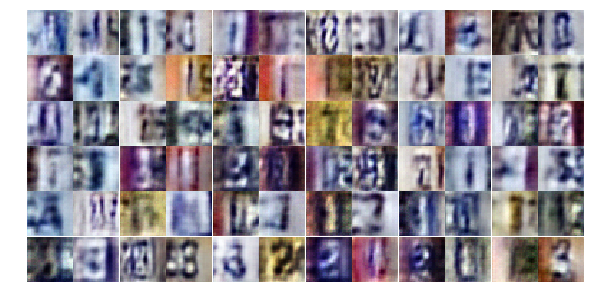

Epoch 5/25... Discriminator Loss: 0.5791... Generator Loss: 1.5859
Epoch 5/25... Discriminator Loss: 0.6533... Generator Loss: 1.3575
Epoch 5/25... Discriminator Loss: 0.8485... Generator Loss: 0.9073
Epoch 5/25... Discriminator Loss: 1.4125... Generator Loss: 0.4069
Epoch 5/25... Discriminator Loss: 0.5032... Generator Loss: 1.6074
Epoch 5/25... Discriminator Loss: 0.5497... Generator Loss: 1.4006
Epoch 5/25... Discriminator Loss: 0.7203... Generator Loss: 0.9614
Epoch 5/25... Discriminator Loss: 1.5640... Generator Loss: 0.4420
Epoch 5/25... Discriminator Loss: 0.6357... Generator Loss: 1.1047
Epoch 5/25... Discriminator Loss: 0.3674... Generator Loss: 1.6321


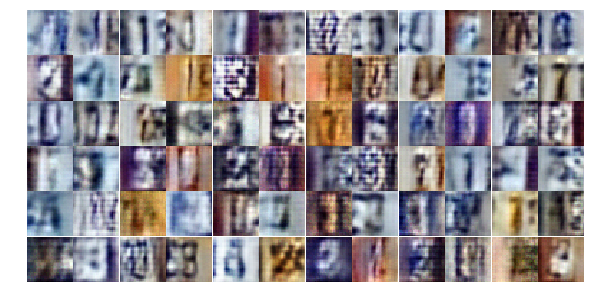

Epoch 5/25... Discriminator Loss: 0.5831... Generator Loss: 1.2464
Epoch 5/25... Discriminator Loss: 0.4328... Generator Loss: 1.9324
Epoch 5/25... Discriminator Loss: 1.0237... Generator Loss: 2.7599
Epoch 5/25... Discriminator Loss: 0.5132... Generator Loss: 1.3748
Epoch 5/25... Discriminator Loss: 0.9776... Generator Loss: 0.8776
Epoch 5/25... Discriminator Loss: 0.5277... Generator Loss: 1.5477
Epoch 5/25... Discriminator Loss: 1.0147... Generator Loss: 0.6461
Epoch 5/25... Discriminator Loss: 0.4548... Generator Loss: 1.5302
Epoch 5/25... Discriminator Loss: 0.9112... Generator Loss: 0.7336
Epoch 5/25... Discriminator Loss: 0.3953... Generator Loss: 1.7712


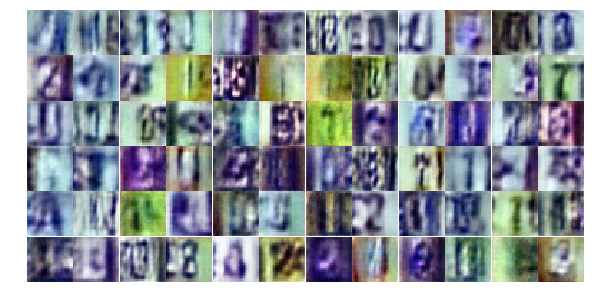

Epoch 5/25... Discriminator Loss: 0.4083... Generator Loss: 2.4599
Epoch 5/25... Discriminator Loss: 0.7801... Generator Loss: 0.7797
Epoch 5/25... Discriminator Loss: 0.7688... Generator Loss: 1.3441
Epoch 5/25... Discriminator Loss: 1.6740... Generator Loss: 0.2907
Epoch 5/25... Discriminator Loss: 0.9968... Generator Loss: 0.7080
Epoch 5/25... Discriminator Loss: 0.6289... Generator Loss: 1.0726
Epoch 5/25... Discriminator Loss: 1.2041... Generator Loss: 0.5627
Epoch 5/25... Discriminator Loss: 0.5318... Generator Loss: 2.0100
Epoch 5/25... Discriminator Loss: 1.2657... Generator Loss: 0.4782
Epoch 5/25... Discriminator Loss: 0.5994... Generator Loss: 2.0722


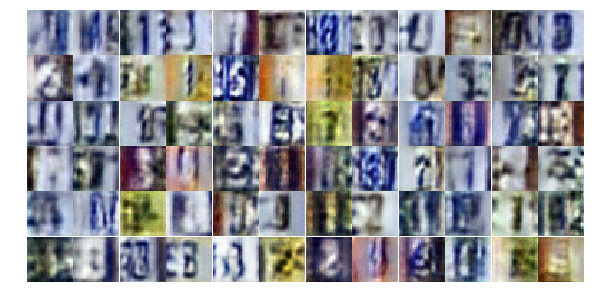

Epoch 5/25... Discriminator Loss: 0.6222... Generator Loss: 1.0584
Epoch 5/25... Discriminator Loss: 1.1520... Generator Loss: 0.5272
Epoch 5/25... Discriminator Loss: 0.8368... Generator Loss: 0.7959
Epoch 5/25... Discriminator Loss: 0.9422... Generator Loss: 0.6266
Epoch 5/25... Discriminator Loss: 0.6123... Generator Loss: 1.0902
Epoch 5/25... Discriminator Loss: 0.8687... Generator Loss: 1.7221
Epoch 6/25... Discriminator Loss: 0.5131... Generator Loss: 1.4264
Epoch 6/25... Discriminator Loss: 0.4000... Generator Loss: 1.6432
Epoch 6/25... Discriminator Loss: 1.7779... Generator Loss: 0.3214
Epoch 6/25... Discriminator Loss: 1.3519... Generator Loss: 0.3887


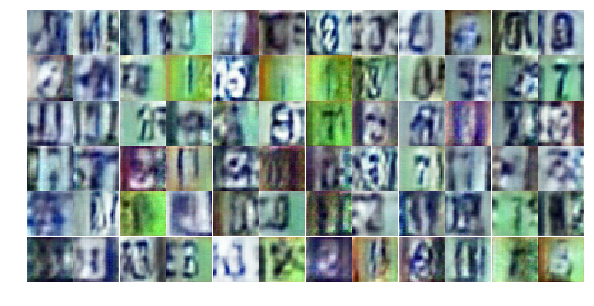

Epoch 6/25... Discriminator Loss: 0.8433... Generator Loss: 0.8249
Epoch 6/25... Discriminator Loss: 0.6911... Generator Loss: 1.2868
Epoch 6/25... Discriminator Loss: 0.5876... Generator Loss: 1.5201
Epoch 6/25... Discriminator Loss: 0.8210... Generator Loss: 0.8627
Epoch 6/25... Discriminator Loss: 1.0588... Generator Loss: 0.5944
Epoch 6/25... Discriminator Loss: 0.6844... Generator Loss: 0.9897
Epoch 6/25... Discriminator Loss: 0.5150... Generator Loss: 1.7180
Epoch 6/25... Discriminator Loss: 0.7714... Generator Loss: 1.4579
Epoch 6/25... Discriminator Loss: 0.7896... Generator Loss: 1.1317
Epoch 6/25... Discriminator Loss: 0.6251... Generator Loss: 1.3587


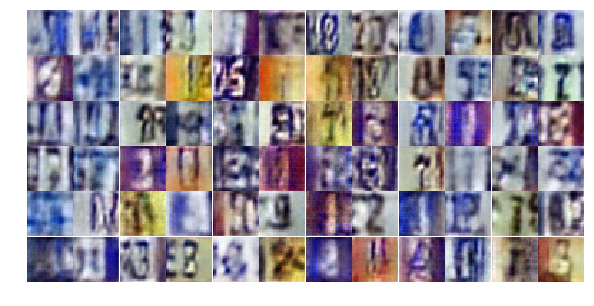

Epoch 6/25... Discriminator Loss: 0.5598... Generator Loss: 1.3171
Epoch 6/25... Discriminator Loss: 0.6280... Generator Loss: 1.6255
Epoch 6/25... Discriminator Loss: 1.1634... Generator Loss: 0.5016
Epoch 6/25... Discriminator Loss: 0.4036... Generator Loss: 1.8731
Epoch 6/25... Discriminator Loss: 0.3871... Generator Loss: 1.8091
Epoch 6/25... Discriminator Loss: 0.5001... Generator Loss: 1.6044
Epoch 6/25... Discriminator Loss: 0.6180... Generator Loss: 1.1674
Epoch 6/25... Discriminator Loss: 0.5515... Generator Loss: 1.3490
Epoch 6/25... Discriminator Loss: 0.7985... Generator Loss: 2.7047
Epoch 6/25... Discriminator Loss: 1.0063... Generator Loss: 0.7266


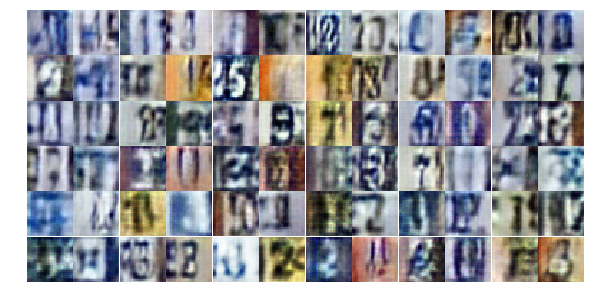

Epoch 6/25... Discriminator Loss: 0.9785... Generator Loss: 0.6807
Epoch 6/25... Discriminator Loss: 0.8747... Generator Loss: 2.5269
Epoch 6/25... Discriminator Loss: 0.9190... Generator Loss: 0.6801
Epoch 6/25... Discriminator Loss: 0.6094... Generator Loss: 1.1769
Epoch 6/25... Discriminator Loss: 1.2890... Generator Loss: 3.3762
Epoch 6/25... Discriminator Loss: 0.8924... Generator Loss: 0.9301
Epoch 6/25... Discriminator Loss: 0.5247... Generator Loss: 1.2743
Epoch 6/25... Discriminator Loss: 0.5867... Generator Loss: 1.1554
Epoch 6/25... Discriminator Loss: 0.5327... Generator Loss: 1.9292
Epoch 6/25... Discriminator Loss: 0.3749... Generator Loss: 1.8566


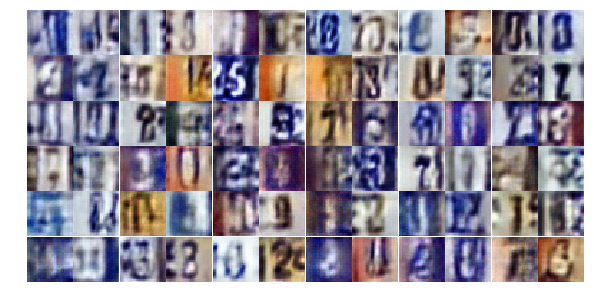

Epoch 6/25... Discriminator Loss: 1.5717... Generator Loss: 0.3231
Epoch 6/25... Discriminator Loss: 0.7571... Generator Loss: 1.1034
Epoch 6/25... Discriminator Loss: 0.5837... Generator Loss: 1.4796
Epoch 6/25... Discriminator Loss: 0.5534... Generator Loss: 1.2291
Epoch 6/25... Discriminator Loss: 0.5020... Generator Loss: 1.8260
Epoch 6/25... Discriminator Loss: 0.4378... Generator Loss: 1.4570
Epoch 6/25... Discriminator Loss: 0.4237... Generator Loss: 1.7867
Epoch 6/25... Discriminator Loss: 0.4733... Generator Loss: 2.6551
Epoch 6/25... Discriminator Loss: 0.9304... Generator Loss: 0.7790
Epoch 6/25... Discriminator Loss: 0.3960... Generator Loss: 1.4542


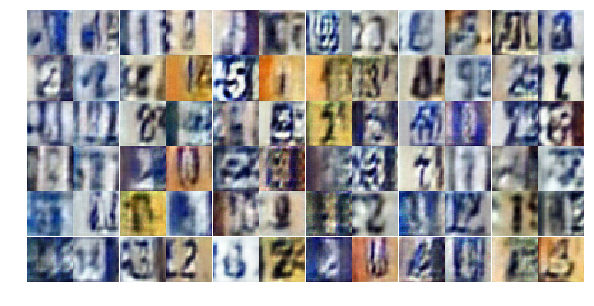

Epoch 6/25... Discriminator Loss: 1.9377... Generator Loss: 5.0946
Epoch 6/25... Discriminator Loss: 1.0761... Generator Loss: 2.2079
Epoch 6/25... Discriminator Loss: 0.7004... Generator Loss: 1.2442
Epoch 6/25... Discriminator Loss: 0.5526... Generator Loss: 1.4558
Epoch 6/25... Discriminator Loss: 0.4354... Generator Loss: 1.9292
Epoch 6/25... Discriminator Loss: 0.8104... Generator Loss: 0.8172
Epoch 6/25... Discriminator Loss: 0.6676... Generator Loss: 0.9683
Epoch 6/25... Discriminator Loss: 1.3298... Generator Loss: 0.4193
Epoch 6/25... Discriminator Loss: 0.5518... Generator Loss: 1.3325
Epoch 6/25... Discriminator Loss: 1.5510... Generator Loss: 0.3279


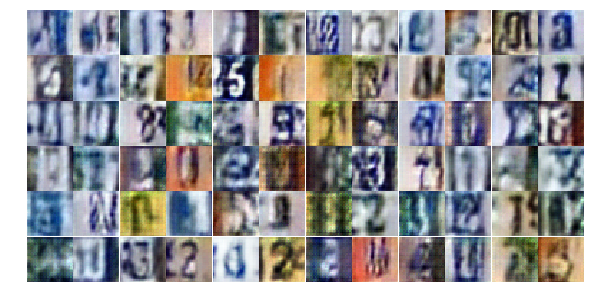

Epoch 6/25... Discriminator Loss: 0.7294... Generator Loss: 1.1878
Epoch 6/25... Discriminator Loss: 0.8613... Generator Loss: 0.6960
Epoch 6/25... Discriminator Loss: 0.8034... Generator Loss: 0.8845
Epoch 7/25... Discriminator Loss: 0.5778... Generator Loss: 1.6977
Epoch 7/25... Discriminator Loss: 0.5855... Generator Loss: 1.3461
Epoch 7/25... Discriminator Loss: 0.6732... Generator Loss: 1.2990
Epoch 7/25... Discriminator Loss: 0.5738... Generator Loss: 1.4060
Epoch 7/25... Discriminator Loss: 0.4999... Generator Loss: 1.5242
Epoch 7/25... Discriminator Loss: 0.4548... Generator Loss: 1.9614
Epoch 7/25... Discriminator Loss: 1.0500... Generator Loss: 0.6064


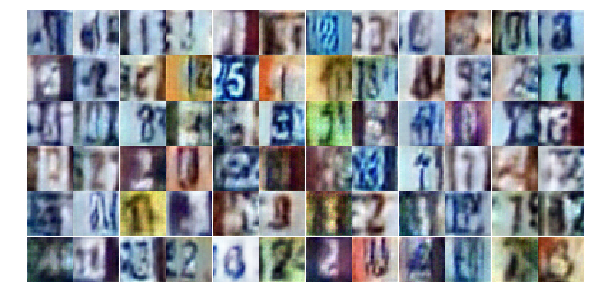

Epoch 7/25... Discriminator Loss: 0.4311... Generator Loss: 2.1676
Epoch 7/25... Discriminator Loss: 0.8278... Generator Loss: 0.7829
Epoch 7/25... Discriminator Loss: 0.7530... Generator Loss: 1.1047
Epoch 7/25... Discriminator Loss: 0.5823... Generator Loss: 1.9391
Epoch 7/25... Discriminator Loss: 0.5179... Generator Loss: 1.3155
Epoch 7/25... Discriminator Loss: 0.4963... Generator Loss: 1.2699
Epoch 7/25... Discriminator Loss: 0.9092... Generator Loss: 2.1217
Epoch 7/25... Discriminator Loss: 0.6829... Generator Loss: 1.2499
Epoch 7/25... Discriminator Loss: 0.8438... Generator Loss: 2.7145
Epoch 7/25... Discriminator Loss: 0.7946... Generator Loss: 0.8465


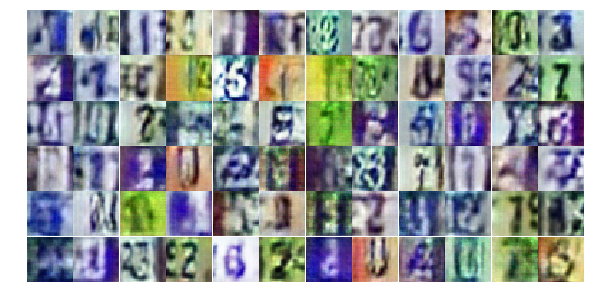

Epoch 7/25... Discriminator Loss: 0.5956... Generator Loss: 1.2839
Epoch 7/25... Discriminator Loss: 0.6024... Generator Loss: 1.1145
Epoch 7/25... Discriminator Loss: 0.9594... Generator Loss: 0.6624
Epoch 7/25... Discriminator Loss: 0.9572... Generator Loss: 0.7177
Epoch 7/25... Discriminator Loss: 0.4898... Generator Loss: 1.5342
Epoch 7/25... Discriminator Loss: 0.7367... Generator Loss: 0.9080
Epoch 7/25... Discriminator Loss: 0.7221... Generator Loss: 0.9522
Epoch 7/25... Discriminator Loss: 0.8116... Generator Loss: 0.8889
Epoch 7/25... Discriminator Loss: 0.4565... Generator Loss: 1.6207
Epoch 7/25... Discriminator Loss: 0.6675... Generator Loss: 1.8474


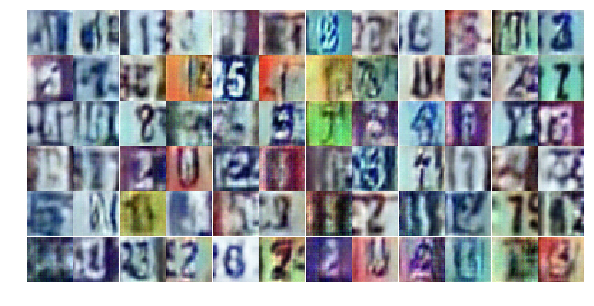

Epoch 7/25... Discriminator Loss: 0.6660... Generator Loss: 1.0976
Epoch 7/25... Discriminator Loss: 1.1292... Generator Loss: 0.5019
Epoch 7/25... Discriminator Loss: 0.4906... Generator Loss: 1.4348
Epoch 7/25... Discriminator Loss: 0.6380... Generator Loss: 1.0786
Epoch 7/25... Discriminator Loss: 0.6698... Generator Loss: 1.0436
Epoch 7/25... Discriminator Loss: 0.7346... Generator Loss: 1.0969
Epoch 7/25... Discriminator Loss: 1.0652... Generator Loss: 0.6034
Epoch 7/25... Discriminator Loss: 1.0378... Generator Loss: 0.6735
Epoch 7/25... Discriminator Loss: 0.8222... Generator Loss: 0.9502
Epoch 7/25... Discriminator Loss: 0.5711... Generator Loss: 1.6366


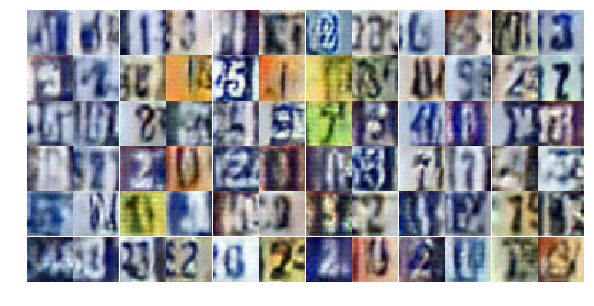

Epoch 7/25... Discriminator Loss: 1.1217... Generator Loss: 0.5708
Epoch 7/25... Discriminator Loss: 1.2555... Generator Loss: 0.5273
Epoch 7/25... Discriminator Loss: 0.7576... Generator Loss: 1.0032
Epoch 7/25... Discriminator Loss: 0.4909... Generator Loss: 1.5343
Epoch 7/25... Discriminator Loss: 0.8856... Generator Loss: 0.7617
Epoch 7/25... Discriminator Loss: 0.5964... Generator Loss: 1.3367
Epoch 7/25... Discriminator Loss: 0.5682... Generator Loss: 1.1126
Epoch 7/25... Discriminator Loss: 0.9930... Generator Loss: 1.3296
Epoch 7/25... Discriminator Loss: 0.4405... Generator Loss: 1.9369
Epoch 7/25... Discriminator Loss: 0.9325... Generator Loss: 0.9309


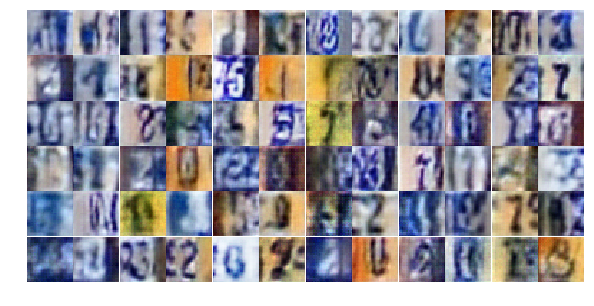

Epoch 7/25... Discriminator Loss: 0.5321... Generator Loss: 1.4658
Epoch 7/25... Discriminator Loss: 0.8027... Generator Loss: 3.3169
Epoch 7/25... Discriminator Loss: 0.7259... Generator Loss: 1.3201
Epoch 7/25... Discriminator Loss: 0.7127... Generator Loss: 1.0486
Epoch 7/25... Discriminator Loss: 0.5654... Generator Loss: 1.4100
Epoch 7/25... Discriminator Loss: 0.4527... Generator Loss: 1.6441
Epoch 7/25... Discriminator Loss: 1.1722... Generator Loss: 0.5200
Epoch 7/25... Discriminator Loss: 0.6572... Generator Loss: 1.3374
Epoch 7/25... Discriminator Loss: 0.5047... Generator Loss: 1.3107
Epoch 7/25... Discriminator Loss: 0.7144... Generator Loss: 0.9391


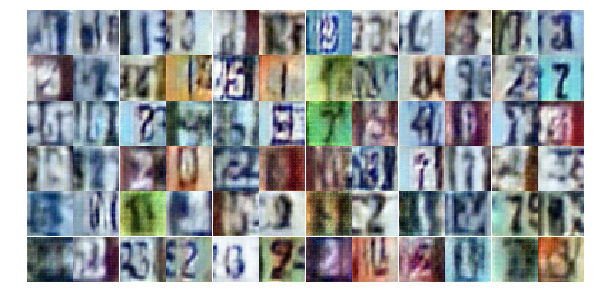

Epoch 7/25... Discriminator Loss: 0.5744... Generator Loss: 1.4454
Epoch 8/25... Discriminator Loss: 0.6975... Generator Loss: 0.9551
Epoch 8/25... Discriminator Loss: 0.8447... Generator Loss: 0.6899
Epoch 8/25... Discriminator Loss: 0.6072... Generator Loss: 1.1461
Epoch 8/25... Discriminator Loss: 0.5377... Generator Loss: 1.3581
Epoch 8/25... Discriminator Loss: 0.8674... Generator Loss: 0.8904
Epoch 8/25... Discriminator Loss: 0.8553... Generator Loss: 0.7305
Epoch 8/25... Discriminator Loss: 0.4929... Generator Loss: 1.3169
Epoch 8/25... Discriminator Loss: 1.1346... Generator Loss: 0.5542
Epoch 8/25... Discriminator Loss: 0.7937... Generator Loss: 0.8836


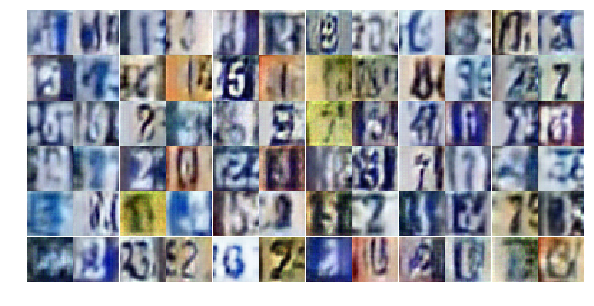

Epoch 8/25... Discriminator Loss: 0.5897... Generator Loss: 1.2222
Epoch 8/25... Discriminator Loss: 0.4902... Generator Loss: 1.3280
Epoch 8/25... Discriminator Loss: 1.1134... Generator Loss: 0.6290
Epoch 8/25... Discriminator Loss: 0.2933... Generator Loss: 2.3195
Epoch 8/25... Discriminator Loss: 0.6956... Generator Loss: 1.0548
Epoch 8/25... Discriminator Loss: 1.3201... Generator Loss: 3.1366
Epoch 8/25... Discriminator Loss: 0.4463... Generator Loss: 1.7510
Epoch 8/25... Discriminator Loss: 0.4602... Generator Loss: 1.7494
Epoch 8/25... Discriminator Loss: 0.5503... Generator Loss: 1.2837
Epoch 8/25... Discriminator Loss: 1.4562... Generator Loss: 0.3524


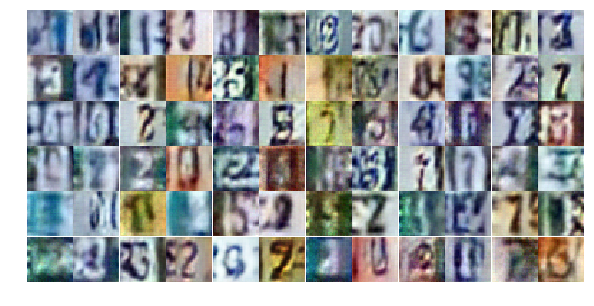

Epoch 8/25... Discriminator Loss: 0.4964... Generator Loss: 1.5527
Epoch 8/25... Discriminator Loss: 0.4576... Generator Loss: 1.3514
Epoch 8/25... Discriminator Loss: 0.6770... Generator Loss: 0.9484
Epoch 8/25... Discriminator Loss: 0.5780... Generator Loss: 1.3997
Epoch 8/25... Discriminator Loss: 0.4272... Generator Loss: 1.9287
Epoch 8/25... Discriminator Loss: 0.4289... Generator Loss: 1.6861
Epoch 8/25... Discriminator Loss: 0.7516... Generator Loss: 1.9238
Epoch 8/25... Discriminator Loss: 0.4948... Generator Loss: 1.2763
Epoch 8/25... Discriminator Loss: 0.6872... Generator Loss: 1.1179
Epoch 8/25... Discriminator Loss: 0.7873... Generator Loss: 0.8609


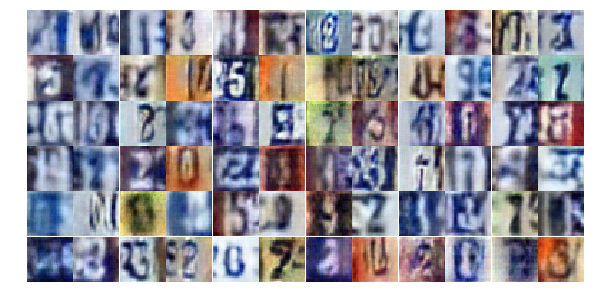

Epoch 8/25... Discriminator Loss: 0.6066... Generator Loss: 1.1900
Epoch 8/25... Discriminator Loss: 0.8184... Generator Loss: 0.7836
Epoch 8/25... Discriminator Loss: 0.4124... Generator Loss: 1.7660
Epoch 8/25... Discriminator Loss: 1.0762... Generator Loss: 0.5851
Epoch 8/25... Discriminator Loss: 0.8599... Generator Loss: 0.7851
Epoch 8/25... Discriminator Loss: 0.4849... Generator Loss: 1.2535
Epoch 8/25... Discriminator Loss: 0.7111... Generator Loss: 0.9685
Epoch 8/25... Discriminator Loss: 0.6208... Generator Loss: 1.1451
Epoch 8/25... Discriminator Loss: 0.6546... Generator Loss: 1.0540
Epoch 8/25... Discriminator Loss: 0.3936... Generator Loss: 1.5191


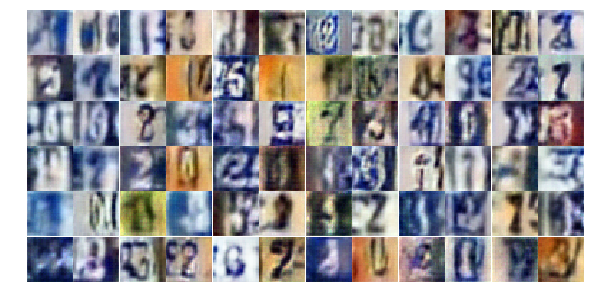

Epoch 8/25... Discriminator Loss: 0.4866... Generator Loss: 2.0519
Epoch 8/25... Discriminator Loss: 1.5458... Generator Loss: 0.3739
Epoch 8/25... Discriminator Loss: 0.5662... Generator Loss: 1.1890
Epoch 8/25... Discriminator Loss: 0.7055... Generator Loss: 0.9712
Epoch 8/25... Discriminator Loss: 2.6424... Generator Loss: 4.1012
Epoch 8/25... Discriminator Loss: 1.2511... Generator Loss: 0.5113
Epoch 8/25... Discriminator Loss: 0.4369... Generator Loss: 1.6360
Epoch 8/25... Discriminator Loss: 0.4897... Generator Loss: 1.5659
Epoch 8/25... Discriminator Loss: 0.5214... Generator Loss: 1.4597
Epoch 8/25... Discriminator Loss: 0.7233... Generator Loss: 1.0683


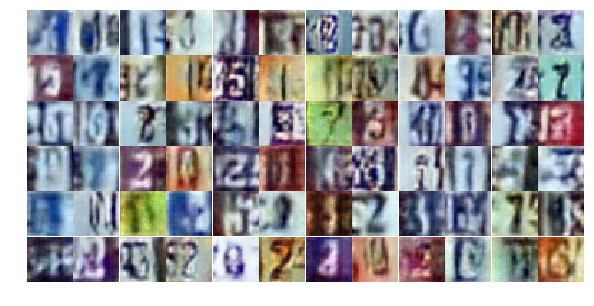

Epoch 8/25... Discriminator Loss: 0.5340... Generator Loss: 1.6526
Epoch 8/25... Discriminator Loss: 0.3095... Generator Loss: 1.9932
Epoch 8/25... Discriminator Loss: 0.3815... Generator Loss: 1.7425
Epoch 8/25... Discriminator Loss: 0.8668... Generator Loss: 0.7201
Epoch 8/25... Discriminator Loss: 0.4704... Generator Loss: 1.6706
Epoch 8/25... Discriminator Loss: 1.2273... Generator Loss: 0.4875
Epoch 8/25... Discriminator Loss: 0.5501... Generator Loss: 1.1814
Epoch 8/25... Discriminator Loss: 0.5121... Generator Loss: 1.5207
Epoch 9/25... Discriminator Loss: 1.0734... Generator Loss: 0.5447
Epoch 9/25... Discriminator Loss: 0.5920... Generator Loss: 1.3321


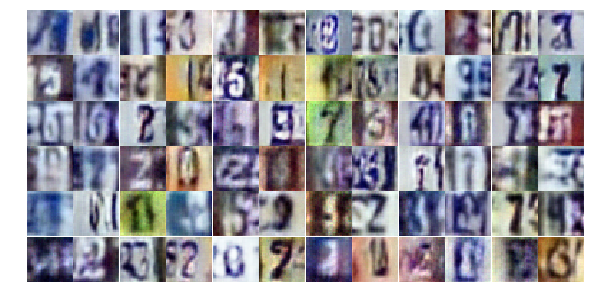

Epoch 9/25... Discriminator Loss: 0.7218... Generator Loss: 0.9380
Epoch 9/25... Discriminator Loss: 0.5509... Generator Loss: 1.8755
Epoch 9/25... Discriminator Loss: 0.9938... Generator Loss: 0.6333
Epoch 9/25... Discriminator Loss: 0.3866... Generator Loss: 2.1557
Epoch 9/25... Discriminator Loss: 1.1318... Generator Loss: 0.5250
Epoch 9/25... Discriminator Loss: 0.4727... Generator Loss: 1.7970
Epoch 9/25... Discriminator Loss: 0.6086... Generator Loss: 1.3187
Epoch 9/25... Discriminator Loss: 0.5328... Generator Loss: 1.2392
Epoch 9/25... Discriminator Loss: 0.7596... Generator Loss: 0.9339
Epoch 9/25... Discriminator Loss: 0.6981... Generator Loss: 1.0251


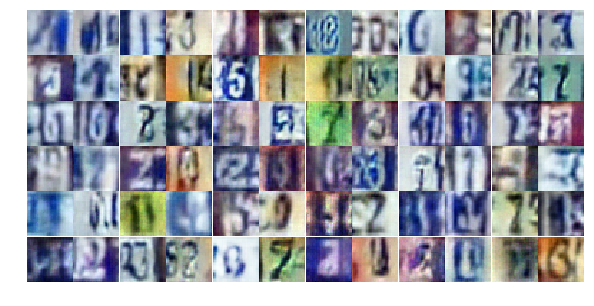

Epoch 9/25... Discriminator Loss: 0.8810... Generator Loss: 0.7126
Epoch 9/25... Discriminator Loss: 1.3540... Generator Loss: 0.4130
Epoch 9/25... Discriminator Loss: 1.2552... Generator Loss: 0.5255
Epoch 9/25... Discriminator Loss: 0.8574... Generator Loss: 1.8482
Epoch 9/25... Discriminator Loss: 0.7215... Generator Loss: 1.0835
Epoch 9/25... Discriminator Loss: 0.5465... Generator Loss: 1.3876
Epoch 9/25... Discriminator Loss: 0.7946... Generator Loss: 0.8331
Epoch 9/25... Discriminator Loss: 0.6204... Generator Loss: 1.0720
Epoch 9/25... Discriminator Loss: 1.0682... Generator Loss: 0.5629
Epoch 9/25... Discriminator Loss: 1.0228... Generator Loss: 0.6015


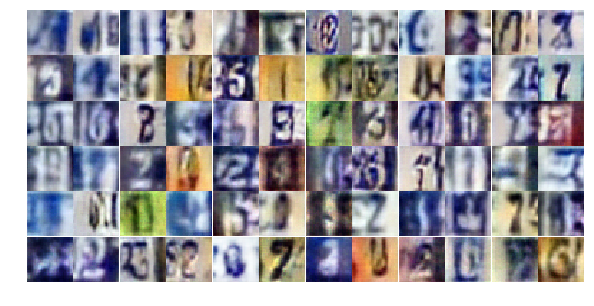

Epoch 9/25... Discriminator Loss: 0.7372... Generator Loss: 1.2181
Epoch 9/25... Discriminator Loss: 0.6152... Generator Loss: 1.2324
Epoch 9/25... Discriminator Loss: 0.4824... Generator Loss: 1.6256
Epoch 9/25... Discriminator Loss: 0.6408... Generator Loss: 1.9404
Epoch 9/25... Discriminator Loss: 0.6315... Generator Loss: 1.4857
Epoch 9/25... Discriminator Loss: 0.6310... Generator Loss: 1.1220
Epoch 9/25... Discriminator Loss: 0.9188... Generator Loss: 0.6876
Epoch 9/25... Discriminator Loss: 0.5139... Generator Loss: 1.4893
Epoch 9/25... Discriminator Loss: 0.5431... Generator Loss: 1.2346
Epoch 9/25... Discriminator Loss: 0.4212... Generator Loss: 1.4832


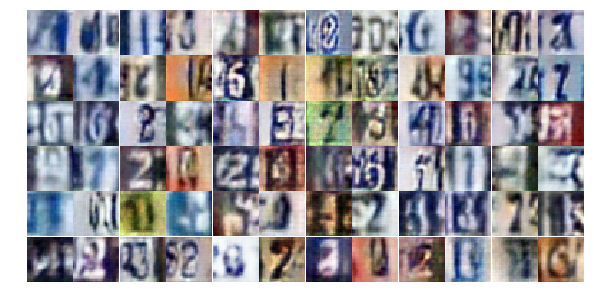

Epoch 9/25... Discriminator Loss: 0.5595... Generator Loss: 1.2823
Epoch 9/25... Discriminator Loss: 0.5300... Generator Loss: 1.2170
Epoch 9/25... Discriminator Loss: 0.9307... Generator Loss: 0.7063
Epoch 9/25... Discriminator Loss: 0.6132... Generator Loss: 1.1171
Epoch 9/25... Discriminator Loss: 0.6992... Generator Loss: 0.9297
Epoch 9/25... Discriminator Loss: 0.6622... Generator Loss: 1.1463
Epoch 9/25... Discriminator Loss: 0.5659... Generator Loss: 1.2711
Epoch 9/25... Discriminator Loss: 0.5914... Generator Loss: 1.1536
Epoch 9/25... Discriminator Loss: 1.4526... Generator Loss: 0.3396
Epoch 9/25... Discriminator Loss: 0.6806... Generator Loss: 0.9510


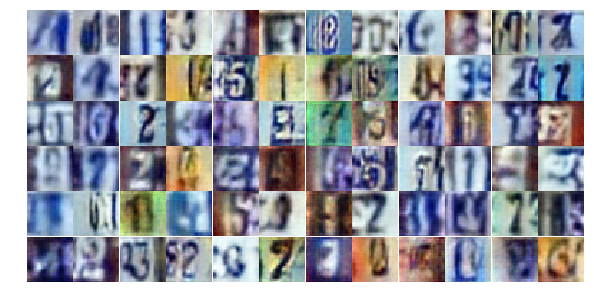

Epoch 9/25... Discriminator Loss: 0.5572... Generator Loss: 1.1538
Epoch 9/25... Discriminator Loss: 0.5597... Generator Loss: 1.7920
Epoch 9/25... Discriminator Loss: 0.4002... Generator Loss: 2.0842
Epoch 9/25... Discriminator Loss: 0.6705... Generator Loss: 0.9595
Epoch 9/25... Discriminator Loss: 0.4826... Generator Loss: 1.6745
Epoch 9/25... Discriminator Loss: 0.8188... Generator Loss: 0.9206
Epoch 9/25... Discriminator Loss: 0.6333... Generator Loss: 1.0472
Epoch 9/25... Discriminator Loss: 0.7159... Generator Loss: 0.9028
Epoch 9/25... Discriminator Loss: 0.4309... Generator Loss: 1.8875
Epoch 9/25... Discriminator Loss: 0.5254... Generator Loss: 3.2597


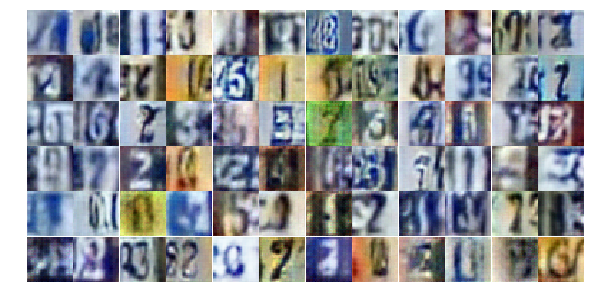

Epoch 9/25... Discriminator Loss: 0.7075... Generator Loss: 1.8178
Epoch 9/25... Discriminator Loss: 2.2219... Generator Loss: 4.7606
Epoch 9/25... Discriminator Loss: 1.2812... Generator Loss: 0.4365
Epoch 9/25... Discriminator Loss: 0.8119... Generator Loss: 0.7937
Epoch 9/25... Discriminator Loss: 0.8703... Generator Loss: 0.8262
Epoch 10/25... Discriminator Loss: 1.3760... Generator Loss: 0.8357
Epoch 10/25... Discriminator Loss: 0.5175... Generator Loss: 1.4452
Epoch 10/25... Discriminator Loss: 0.6096... Generator Loss: 1.6221
Epoch 10/25... Discriminator Loss: 0.8032... Generator Loss: 0.8994
Epoch 10/25... Discriminator Loss: 1.3175... Generator Loss: 0.4295


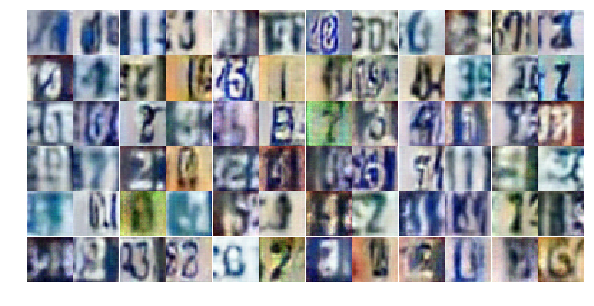

Epoch 10/25... Discriminator Loss: 0.8571... Generator Loss: 0.7507
Epoch 10/25... Discriminator Loss: 0.6268... Generator Loss: 1.1493
Epoch 10/25... Discriminator Loss: 0.7330... Generator Loss: 0.9171
Epoch 10/25... Discriminator Loss: 0.6888... Generator Loss: 0.9576
Epoch 10/25... Discriminator Loss: 0.4915... Generator Loss: 1.5622
Epoch 10/25... Discriminator Loss: 0.5131... Generator Loss: 1.6705
Epoch 10/25... Discriminator Loss: 0.5288... Generator Loss: 1.2510
Epoch 10/25... Discriminator Loss: 0.8632... Generator Loss: 0.7866
Epoch 10/25... Discriminator Loss: 0.7961... Generator Loss: 1.7778
Epoch 10/25... Discriminator Loss: 0.6957... Generator Loss: 1.1434


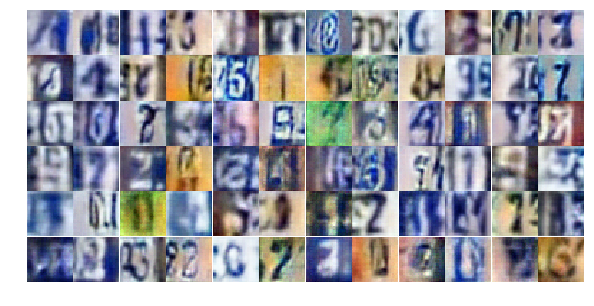

Epoch 10/25... Discriminator Loss: 0.5855... Generator Loss: 2.1346
Epoch 10/25... Discriminator Loss: 0.7096... Generator Loss: 0.9656
Epoch 10/25... Discriminator Loss: 0.7335... Generator Loss: 1.0937
Epoch 10/25... Discriminator Loss: 1.4698... Generator Loss: 0.3876
Epoch 10/25... Discriminator Loss: 0.5268... Generator Loss: 1.3936
Epoch 10/25... Discriminator Loss: 0.5877... Generator Loss: 1.1482
Epoch 10/25... Discriminator Loss: 0.7724... Generator Loss: 0.8929
Epoch 10/25... Discriminator Loss: 0.5559... Generator Loss: 1.2209
Epoch 10/25... Discriminator Loss: 0.6777... Generator Loss: 0.9452
Epoch 10/25... Discriminator Loss: 0.3483... Generator Loss: 1.9405


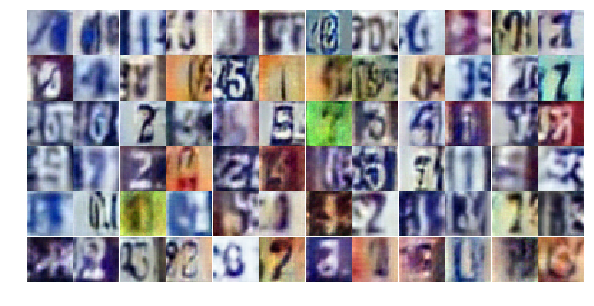

Epoch 10/25... Discriminator Loss: 1.2366... Generator Loss: 0.4594
Epoch 10/25... Discriminator Loss: 1.5432... Generator Loss: 0.3368
Epoch 10/25... Discriminator Loss: 0.4436... Generator Loss: 1.6867
Epoch 10/25... Discriminator Loss: 0.3757... Generator Loss: 1.9708
Epoch 10/25... Discriminator Loss: 1.3019... Generator Loss: 0.4197
Epoch 10/25... Discriminator Loss: 0.8054... Generator Loss: 0.8323
Epoch 10/25... Discriminator Loss: 0.3520... Generator Loss: 1.5969
Epoch 10/25... Discriminator Loss: 0.6496... Generator Loss: 1.6412
Epoch 10/25... Discriminator Loss: 0.5354... Generator Loss: 1.1709
Epoch 10/25... Discriminator Loss: 0.5918... Generator Loss: 1.1606


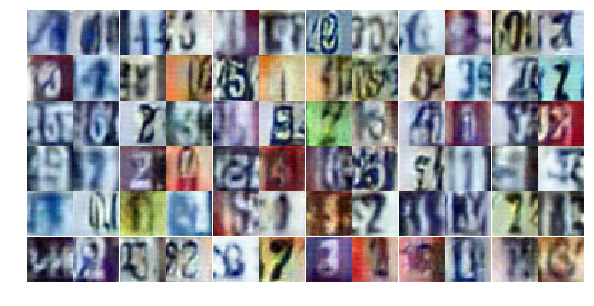

Epoch 10/25... Discriminator Loss: 0.6207... Generator Loss: 1.3036
Epoch 10/25... Discriminator Loss: 0.9259... Generator Loss: 0.6985
Epoch 10/25... Discriminator Loss: 0.4624... Generator Loss: 1.6146
Epoch 10/25... Discriminator Loss: 1.4071... Generator Loss: 0.3724
Epoch 10/25... Discriminator Loss: 0.6274... Generator Loss: 1.1985
Epoch 10/25... Discriminator Loss: 0.4680... Generator Loss: 1.4059
Epoch 10/25... Discriminator Loss: 0.7176... Generator Loss: 1.0449
Epoch 10/25... Discriminator Loss: 0.9473... Generator Loss: 0.7623
Epoch 10/25... Discriminator Loss: 0.6824... Generator Loss: 0.9712
Epoch 10/25... Discriminator Loss: 2.0690... Generator Loss: 4.9580


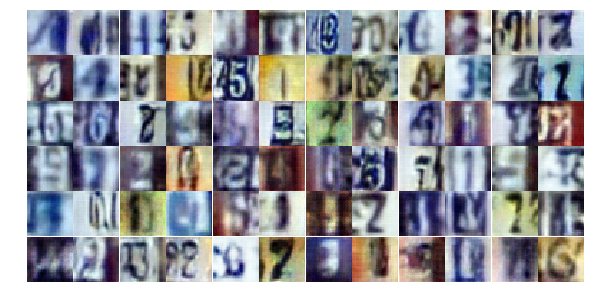

Epoch 10/25... Discriminator Loss: 1.1455... Generator Loss: 0.6679
Epoch 10/25... Discriminator Loss: 0.7207... Generator Loss: 1.4609
Epoch 10/25... Discriminator Loss: 0.8954... Generator Loss: 0.8467
Epoch 10/25... Discriminator Loss: 0.5415... Generator Loss: 1.1821
Epoch 10/25... Discriminator Loss: 0.5526... Generator Loss: 1.5082
Epoch 10/25... Discriminator Loss: 0.6550... Generator Loss: 1.2314
Epoch 10/25... Discriminator Loss: 0.4987... Generator Loss: 1.3187
Epoch 10/25... Discriminator Loss: 0.4436... Generator Loss: 1.6609
Epoch 10/25... Discriminator Loss: 0.6449... Generator Loss: 1.8931
Epoch 10/25... Discriminator Loss: 0.5701... Generator Loss: 1.2815


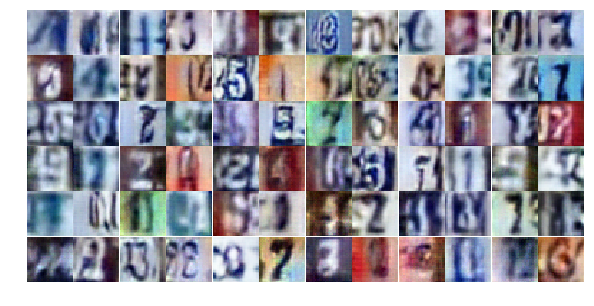

Epoch 10/25... Discriminator Loss: 0.8367... Generator Loss: 1.0196
Epoch 10/25... Discriminator Loss: 0.4100... Generator Loss: 1.4593
Epoch 10/25... Discriminator Loss: 0.4314... Generator Loss: 1.3876
Epoch 11/25... Discriminator Loss: 0.7500... Generator Loss: 1.1071
Epoch 11/25... Discriminator Loss: 0.6911... Generator Loss: 0.9563
Epoch 11/25... Discriminator Loss: 1.0975... Generator Loss: 0.5849
Epoch 11/25... Discriminator Loss: 0.6493... Generator Loss: 1.0358
Epoch 11/25... Discriminator Loss: 0.5674... Generator Loss: 1.9607
Epoch 11/25... Discriminator Loss: 1.5597... Generator Loss: 0.3572
Epoch 11/25... Discriminator Loss: 0.4164... Generator Loss: 1.7140


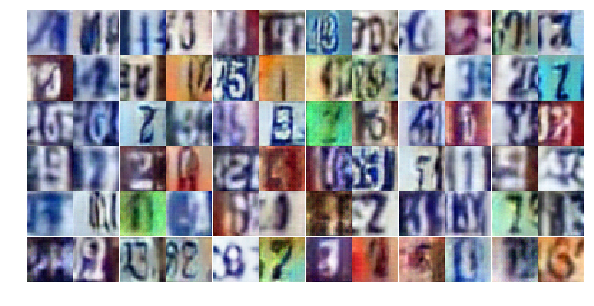

Epoch 11/25... Discriminator Loss: 0.3280... Generator Loss: 1.8002
Epoch 11/25... Discriminator Loss: 0.5413... Generator Loss: 1.2092
Epoch 11/25... Discriminator Loss: 0.4982... Generator Loss: 1.3593
Epoch 11/25... Discriminator Loss: 0.5441... Generator Loss: 1.1288
Epoch 11/25... Discriminator Loss: 0.7367... Generator Loss: 1.1895
Epoch 11/25... Discriminator Loss: 0.2998... Generator Loss: 2.4161
Epoch 11/25... Discriminator Loss: 0.8854... Generator Loss: 1.3229
Epoch 11/25... Discriminator Loss: 0.3294... Generator Loss: 2.1148
Epoch 11/25... Discriminator Loss: 1.2522... Generator Loss: 0.4792
Epoch 11/25... Discriminator Loss: 1.4736... Generator Loss: 0.3508


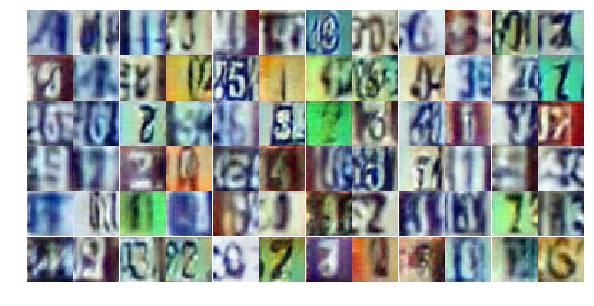

Epoch 11/25... Discriminator Loss: 0.8611... Generator Loss: 0.8555
Epoch 11/25... Discriminator Loss: 0.6569... Generator Loss: 2.0748
Epoch 11/25... Discriminator Loss: 0.7632... Generator Loss: 0.8544
Epoch 11/25... Discriminator Loss: 0.6295... Generator Loss: 1.0466
Epoch 11/25... Discriminator Loss: 0.3522... Generator Loss: 2.0058
Epoch 11/25... Discriminator Loss: 0.3368... Generator Loss: 1.9908
Epoch 11/25... Discriminator Loss: 0.5499... Generator Loss: 1.2093
Epoch 11/25... Discriminator Loss: 1.2510... Generator Loss: 0.5255
Epoch 11/25... Discriminator Loss: 0.4035... Generator Loss: 2.0296
Epoch 11/25... Discriminator Loss: 0.7371... Generator Loss: 0.9038


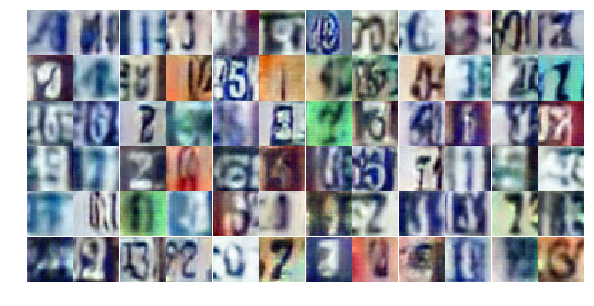

Epoch 11/25... Discriminator Loss: 0.8191... Generator Loss: 0.8959
Epoch 11/25... Discriminator Loss: 0.5800... Generator Loss: 1.4704
Epoch 11/25... Discriminator Loss: 0.9408... Generator Loss: 0.7801
Epoch 11/25... Discriminator Loss: 0.7206... Generator Loss: 3.0615
Epoch 11/25... Discriminator Loss: 0.8338... Generator Loss: 0.8044
Epoch 11/25... Discriminator Loss: 1.0173... Generator Loss: 0.6165
Epoch 11/25... Discriminator Loss: 1.2026... Generator Loss: 0.5398
Epoch 11/25... Discriminator Loss: 1.0932... Generator Loss: 0.5714
Epoch 11/25... Discriminator Loss: 0.5255... Generator Loss: 1.2802
Epoch 11/25... Discriminator Loss: 1.6850... Generator Loss: 0.2889


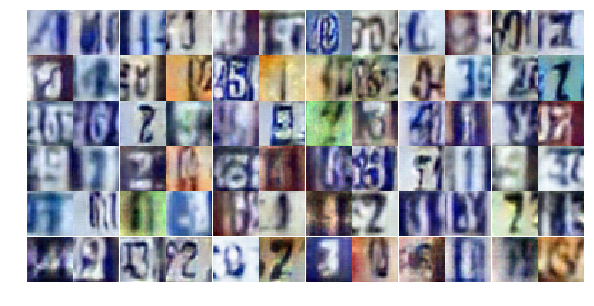

Epoch 11/25... Discriminator Loss: 0.7192... Generator Loss: 0.9625
Epoch 11/25... Discriminator Loss: 0.6765... Generator Loss: 1.1455
Epoch 11/25... Discriminator Loss: 0.6639... Generator Loss: 1.0593
Epoch 11/25... Discriminator Loss: 0.8123... Generator Loss: 0.8972
Epoch 11/25... Discriminator Loss: 0.6880... Generator Loss: 0.9658
Epoch 11/25... Discriminator Loss: 0.6360... Generator Loss: 1.0493
Epoch 11/25... Discriminator Loss: 0.2605... Generator Loss: 2.4327
Epoch 11/25... Discriminator Loss: 0.9488... Generator Loss: 0.6703
Epoch 11/25... Discriminator Loss: 0.8319... Generator Loss: 0.8746
Epoch 11/25... Discriminator Loss: 0.4565... Generator Loss: 1.3074


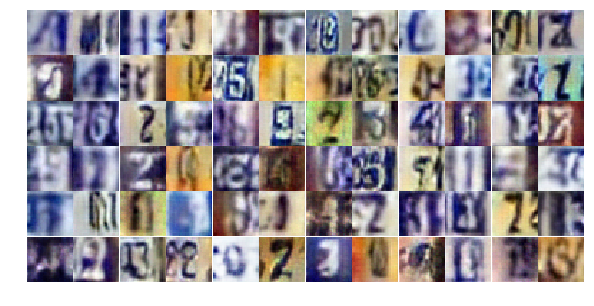

Epoch 11/25... Discriminator Loss: 1.3898... Generator Loss: 0.4398
Epoch 11/25... Discriminator Loss: 1.8179... Generator Loss: 0.2735
Epoch 11/25... Discriminator Loss: 0.9963... Generator Loss: 0.7078
Epoch 11/25... Discriminator Loss: 0.7456... Generator Loss: 0.9018
Epoch 11/25... Discriminator Loss: 0.8147... Generator Loss: 0.8279
Epoch 11/25... Discriminator Loss: 0.6513... Generator Loss: 1.0454
Epoch 11/25... Discriminator Loss: 0.6737... Generator Loss: 1.1701
Epoch 11/25... Discriminator Loss: 0.5564... Generator Loss: 1.4286
Epoch 11/25... Discriminator Loss: 0.8323... Generator Loss: 0.8127
Epoch 11/25... Discriminator Loss: 0.7482... Generator Loss: 0.9853


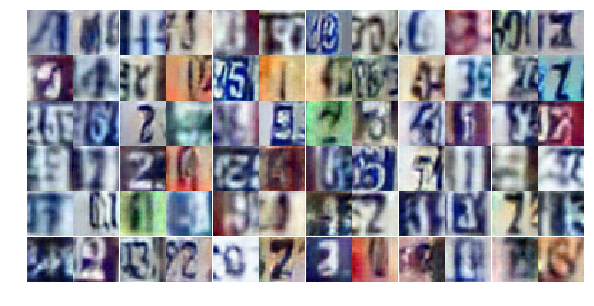

Epoch 12/25... Discriminator Loss: 0.7344... Generator Loss: 1.0557
Epoch 12/25... Discriminator Loss: 0.7380... Generator Loss: 0.9924
Epoch 12/25... Discriminator Loss: 0.7584... Generator Loss: 1.0562
Epoch 12/25... Discriminator Loss: 0.4320... Generator Loss: 1.6559
Epoch 12/25... Discriminator Loss: 0.4910... Generator Loss: 1.3836
Epoch 12/25... Discriminator Loss: 0.9354... Generator Loss: 0.6553
Epoch 12/25... Discriminator Loss: 0.5225... Generator Loss: 1.9558
Epoch 12/25... Discriminator Loss: 0.4413... Generator Loss: 1.9008
Epoch 12/25... Discriminator Loss: 0.7370... Generator Loss: 0.9908
Epoch 12/25... Discriminator Loss: 1.0325... Generator Loss: 0.7490


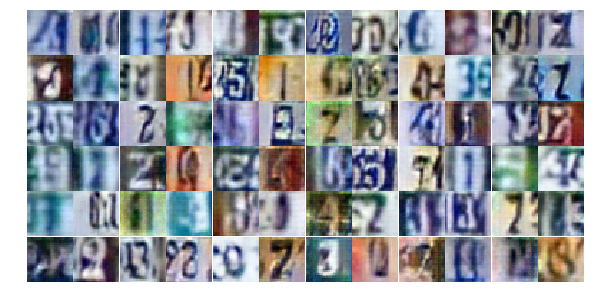

Epoch 12/25... Discriminator Loss: 0.5190... Generator Loss: 1.2682
Epoch 12/25... Discriminator Loss: 0.8664... Generator Loss: 0.7544
Epoch 12/25... Discriminator Loss: 0.3930... Generator Loss: 1.6249
Epoch 12/25... Discriminator Loss: 0.5918... Generator Loss: 1.9405
Epoch 12/25... Discriminator Loss: 0.4416... Generator Loss: 1.6994
Epoch 12/25... Discriminator Loss: 0.8047... Generator Loss: 0.8702
Epoch 12/25... Discriminator Loss: 1.8717... Generator Loss: 0.2087
Epoch 12/25... Discriminator Loss: 0.5290... Generator Loss: 2.1890
Epoch 12/25... Discriminator Loss: 0.6341... Generator Loss: 1.0742
Epoch 12/25... Discriminator Loss: 0.9643... Generator Loss: 0.6614


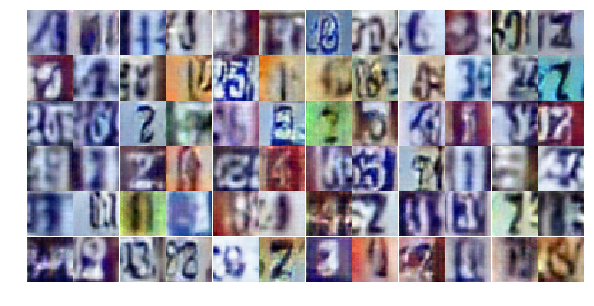

Epoch 12/25... Discriminator Loss: 0.3205... Generator Loss: 2.5244
Epoch 12/25... Discriminator Loss: 0.3942... Generator Loss: 1.4425
Epoch 12/25... Discriminator Loss: 0.6533... Generator Loss: 1.3929
Epoch 12/25... Discriminator Loss: 0.4538... Generator Loss: 1.5295
Epoch 12/25... Discriminator Loss: 0.5258... Generator Loss: 1.3662
Epoch 12/25... Discriminator Loss: 0.4879... Generator Loss: 1.7827
Epoch 12/25... Discriminator Loss: 0.3834... Generator Loss: 1.6813
Epoch 12/25... Discriminator Loss: 0.3769... Generator Loss: 1.5219
Epoch 12/25... Discriminator Loss: 0.5817... Generator Loss: 1.0960
Epoch 12/25... Discriminator Loss: 0.6073... Generator Loss: 1.2176


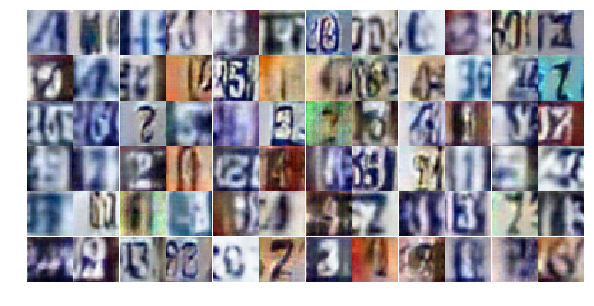

Epoch 12/25... Discriminator Loss: 0.5832... Generator Loss: 1.1817
Epoch 12/25... Discriminator Loss: 1.0448... Generator Loss: 0.6538
Epoch 12/25... Discriminator Loss: 0.7363... Generator Loss: 0.9195
Epoch 12/25... Discriminator Loss: 1.7808... Generator Loss: 0.2840
Epoch 12/25... Discriminator Loss: 0.5220... Generator Loss: 1.4973
Epoch 12/25... Discriminator Loss: 0.6996... Generator Loss: 1.0967
Epoch 12/25... Discriminator Loss: 1.4428... Generator Loss: 0.3802
Epoch 12/25... Discriminator Loss: 1.1758... Generator Loss: 0.5175
Epoch 12/25... Discriminator Loss: 0.4367... Generator Loss: 1.8892
Epoch 12/25... Discriminator Loss: 0.2773... Generator Loss: 2.3221


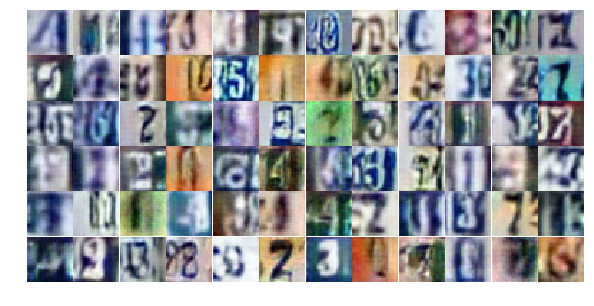

Epoch 12/25... Discriminator Loss: 0.5979... Generator Loss: 1.1948
Epoch 12/25... Discriminator Loss: 0.5478... Generator Loss: 1.0664
Epoch 12/25... Discriminator Loss: 0.4709... Generator Loss: 1.3771
Epoch 12/25... Discriminator Loss: 0.7840... Generator Loss: 0.9153
Epoch 12/25... Discriminator Loss: 0.9325... Generator Loss: 0.6995
Epoch 12/25... Discriminator Loss: 1.3386... Generator Loss: 0.4141
Epoch 12/25... Discriminator Loss: 0.5248... Generator Loss: 1.3443
Epoch 12/25... Discriminator Loss: 0.8075... Generator Loss: 0.8760
Epoch 12/25... Discriminator Loss: 0.4580... Generator Loss: 1.6065
Epoch 12/25... Discriminator Loss: 0.6155... Generator Loss: 1.1818


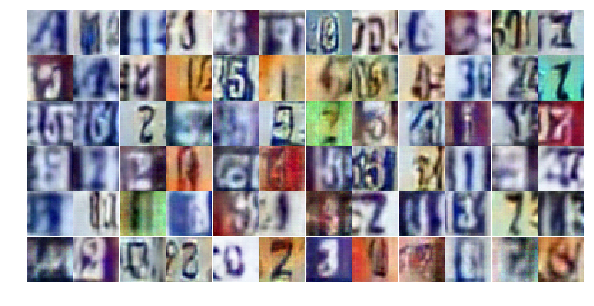

Epoch 12/25... Discriminator Loss: 1.0209... Generator Loss: 0.6636
Epoch 12/25... Discriminator Loss: 1.0025... Generator Loss: 0.6170
Epoch 12/25... Discriminator Loss: 0.5913... Generator Loss: 1.6074
Epoch 12/25... Discriminator Loss: 1.8916... Generator Loss: 0.2534
Epoch 12/25... Discriminator Loss: 1.5349... Generator Loss: 3.7031
Epoch 12/25... Discriminator Loss: 1.1632... Generator Loss: 2.9285
Epoch 12/25... Discriminator Loss: 1.0974... Generator Loss: 0.6131
Epoch 13/25... Discriminator Loss: 0.4591... Generator Loss: 1.4982
Epoch 13/25... Discriminator Loss: 0.4265... Generator Loss: 1.6752
Epoch 13/25... Discriminator Loss: 0.7047... Generator Loss: 1.0043


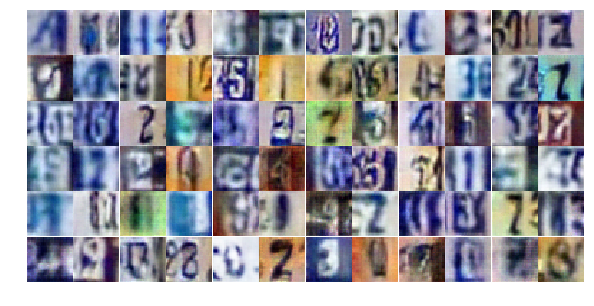

Epoch 13/25... Discriminator Loss: 0.5617... Generator Loss: 1.2353
Epoch 13/25... Discriminator Loss: 0.4922... Generator Loss: 1.5541
Epoch 13/25... Discriminator Loss: 1.1315... Generator Loss: 0.6302
Epoch 13/25... Discriminator Loss: 0.9468... Generator Loss: 0.7086
Epoch 13/25... Discriminator Loss: 0.6639... Generator Loss: 1.0127
Epoch 13/25... Discriminator Loss: 0.4513... Generator Loss: 1.4812
Epoch 13/25... Discriminator Loss: 0.3285... Generator Loss: 1.9688
Epoch 13/25... Discriminator Loss: 0.7804... Generator Loss: 0.8608
Epoch 13/25... Discriminator Loss: 0.6717... Generator Loss: 0.9603
Epoch 13/25... Discriminator Loss: 0.4594... Generator Loss: 2.0249


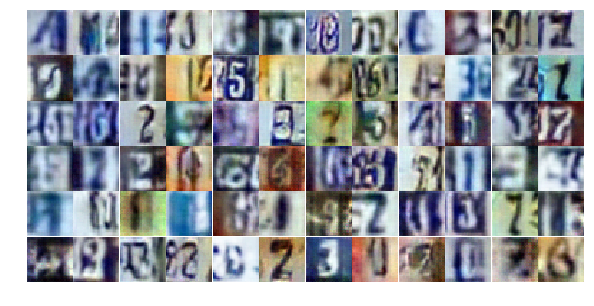

Epoch 13/25... Discriminator Loss: 0.7645... Generator Loss: 0.9530
Epoch 13/25... Discriminator Loss: 0.4100... Generator Loss: 1.5906
Epoch 13/25... Discriminator Loss: 1.2395... Generator Loss: 0.4884
Epoch 13/25... Discriminator Loss: 0.6139... Generator Loss: 1.1920
Epoch 13/25... Discriminator Loss: 0.5518... Generator Loss: 1.3175
Epoch 13/25... Discriminator Loss: 0.9856... Generator Loss: 0.6359
Epoch 13/25... Discriminator Loss: 0.6594... Generator Loss: 1.0382
Epoch 13/25... Discriminator Loss: 0.9616... Generator Loss: 0.6886
Epoch 13/25... Discriminator Loss: 0.6041... Generator Loss: 1.1367
Epoch 13/25... Discriminator Loss: 1.2397... Generator Loss: 0.5170


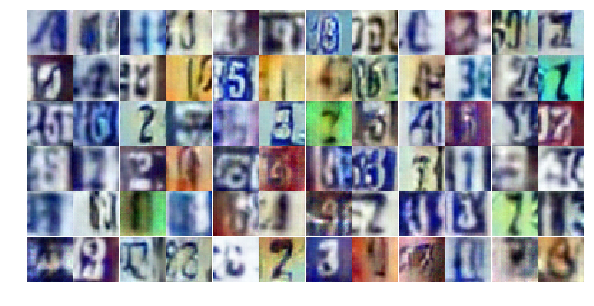

Epoch 13/25... Discriminator Loss: 0.8407... Generator Loss: 0.9016
Epoch 13/25... Discriminator Loss: 0.4464... Generator Loss: 1.4989
Epoch 13/25... Discriminator Loss: 0.6031... Generator Loss: 1.7929
Epoch 13/25... Discriminator Loss: 0.5569... Generator Loss: 1.1411
Epoch 13/25... Discriminator Loss: 0.7854... Generator Loss: 0.8681
Epoch 13/25... Discriminator Loss: 0.6297... Generator Loss: 1.2063
Epoch 13/25... Discriminator Loss: 0.7387... Generator Loss: 0.9919
Epoch 13/25... Discriminator Loss: 0.6226... Generator Loss: 1.3502
Epoch 13/25... Discriminator Loss: 0.5548... Generator Loss: 1.6333
Epoch 13/25... Discriminator Loss: 0.4871... Generator Loss: 1.6334


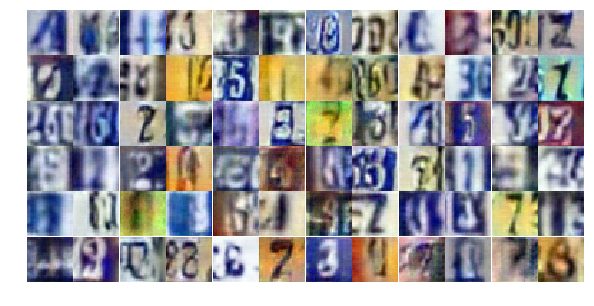

Epoch 13/25... Discriminator Loss: 1.1157... Generator Loss: 0.5697
Epoch 13/25... Discriminator Loss: 2.2700... Generator Loss: 3.3022
Epoch 13/25... Discriminator Loss: 1.4090... Generator Loss: 0.4614
Epoch 13/25... Discriminator Loss: 1.3196... Generator Loss: 0.5159
Epoch 13/25... Discriminator Loss: 0.5123... Generator Loss: 1.4048
Epoch 13/25... Discriminator Loss: 0.4505... Generator Loss: 1.9744
Epoch 13/25... Discriminator Loss: 0.4570... Generator Loss: 1.5010
Epoch 13/25... Discriminator Loss: 0.6730... Generator Loss: 1.0442
Epoch 13/25... Discriminator Loss: 0.4443... Generator Loss: 1.7886
Epoch 13/25... Discriminator Loss: 0.7320... Generator Loss: 0.9745


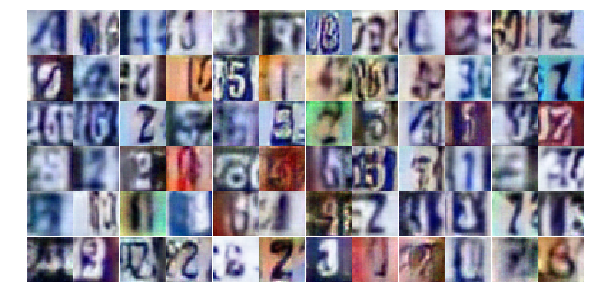

Epoch 13/25... Discriminator Loss: 0.5360... Generator Loss: 1.3046
Epoch 13/25... Discriminator Loss: 0.9536... Generator Loss: 0.7633
Epoch 13/25... Discriminator Loss: 0.8051... Generator Loss: 0.7783
Epoch 13/25... Discriminator Loss: 0.6096... Generator Loss: 1.2807
Epoch 13/25... Discriminator Loss: 0.9675... Generator Loss: 0.7023
Epoch 13/25... Discriminator Loss: 1.0618... Generator Loss: 0.6049
Epoch 13/25... Discriminator Loss: 0.5592... Generator Loss: 1.2857
Epoch 13/25... Discriminator Loss: 0.5318... Generator Loss: 1.2323
Epoch 13/25... Discriminator Loss: 0.9099... Generator Loss: 0.7127
Epoch 13/25... Discriminator Loss: 0.8016... Generator Loss: 0.7973


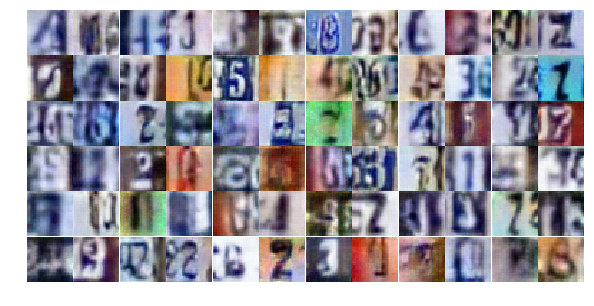

Epoch 13/25... Discriminator Loss: 0.2790... Generator Loss: 2.7037
Epoch 13/25... Discriminator Loss: 1.1918... Generator Loss: 0.5362
Epoch 13/25... Discriminator Loss: 0.7367... Generator Loss: 0.9277
Epoch 13/25... Discriminator Loss: 0.6400... Generator Loss: 1.0136
Epoch 14/25... Discriminator Loss: 0.9690... Generator Loss: 0.7099
Epoch 14/25... Discriminator Loss: 0.7356... Generator Loss: 0.9880
Epoch 14/25... Discriminator Loss: 0.9167... Generator Loss: 0.7393
Epoch 14/25... Discriminator Loss: 0.5846... Generator Loss: 1.9043
Epoch 14/25... Discriminator Loss: 0.4188... Generator Loss: 2.2402
Epoch 14/25... Discriminator Loss: 0.6018... Generator Loss: 1.4097


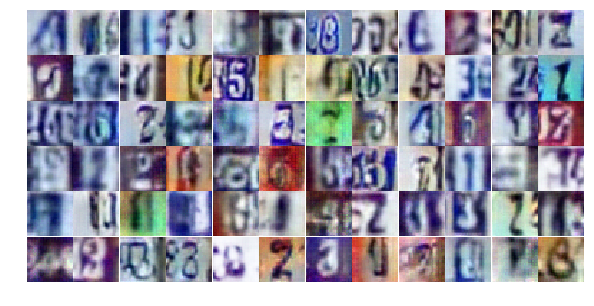

Epoch 14/25... Discriminator Loss: 1.1352... Generator Loss: 3.2835
Epoch 14/25... Discriminator Loss: 1.4005... Generator Loss: 0.3900
Epoch 14/25... Discriminator Loss: 0.5536... Generator Loss: 1.3403
Epoch 14/25... Discriminator Loss: 0.7995... Generator Loss: 0.8846
Epoch 14/25... Discriminator Loss: 1.1249... Generator Loss: 0.6068
Epoch 14/25... Discriminator Loss: 0.4557... Generator Loss: 1.2994
Epoch 14/25... Discriminator Loss: 0.5273... Generator Loss: 2.7496
Epoch 14/25... Discriminator Loss: 1.5029... Generator Loss: 0.3451
Epoch 14/25... Discriminator Loss: 1.2839... Generator Loss: 0.4624
Epoch 14/25... Discriminator Loss: 1.2238... Generator Loss: 0.5010


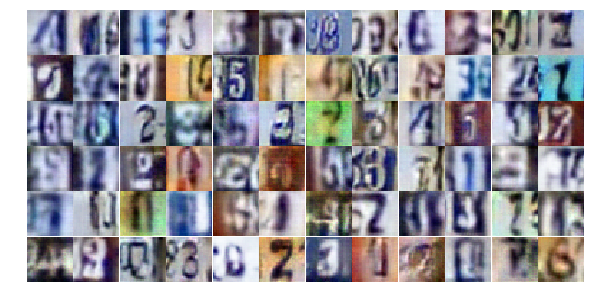

Epoch 14/25... Discriminator Loss: 0.4897... Generator Loss: 1.1471
Epoch 14/25... Discriminator Loss: 0.8314... Generator Loss: 2.6151
Epoch 14/25... Discriminator Loss: 1.0056... Generator Loss: 0.6963
Epoch 14/25... Discriminator Loss: 0.4566... Generator Loss: 1.8699
Epoch 14/25... Discriminator Loss: 0.8563... Generator Loss: 0.8354
Epoch 14/25... Discriminator Loss: 0.7641... Generator Loss: 1.0223
Epoch 14/25... Discriminator Loss: 0.6714... Generator Loss: 1.0140
Epoch 14/25... Discriminator Loss: 0.6498... Generator Loss: 0.9794
Epoch 14/25... Discriminator Loss: 0.5399... Generator Loss: 1.3433
Epoch 14/25... Discriminator Loss: 0.4731... Generator Loss: 1.5525


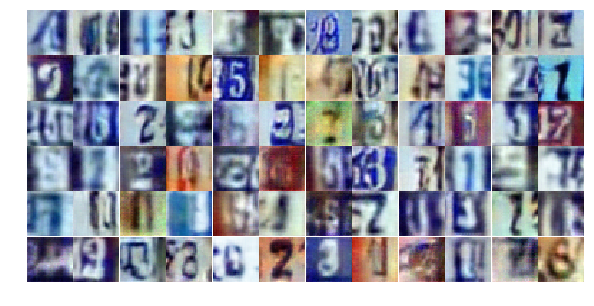

Epoch 14/25... Discriminator Loss: 1.1908... Generator Loss: 0.4901
Epoch 14/25... Discriminator Loss: 0.3456... Generator Loss: 2.0158
Epoch 14/25... Discriminator Loss: 0.5213... Generator Loss: 2.1766
Epoch 14/25... Discriminator Loss: 0.4203... Generator Loss: 1.7587
Epoch 14/25... Discriminator Loss: 0.6220... Generator Loss: 1.2100
Epoch 14/25... Discriminator Loss: 0.6427... Generator Loss: 1.0712
Epoch 14/25... Discriminator Loss: 0.6404... Generator Loss: 1.0634
Epoch 14/25... Discriminator Loss: 0.3522... Generator Loss: 1.9613
Epoch 14/25... Discriminator Loss: 0.3818... Generator Loss: 2.1077
Epoch 14/25... Discriminator Loss: 0.7482... Generator Loss: 0.9654


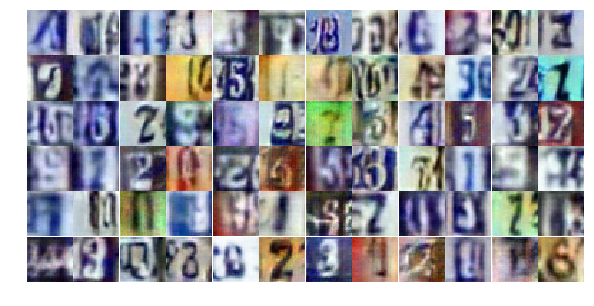

Epoch 14/25... Discriminator Loss: 1.3693... Generator Loss: 0.3972
Epoch 14/25... Discriminator Loss: 0.8530... Generator Loss: 2.1869
Epoch 14/25... Discriminator Loss: 0.6769... Generator Loss: 0.9534
Epoch 14/25... Discriminator Loss: 1.1055... Generator Loss: 0.5637
Epoch 14/25... Discriminator Loss: 0.8392... Generator Loss: 0.7946
Epoch 14/25... Discriminator Loss: 0.7086... Generator Loss: 0.9107
Epoch 14/25... Discriminator Loss: 0.7606... Generator Loss: 0.8812
Epoch 14/25... Discriminator Loss: 0.5077... Generator Loss: 1.6438
Epoch 14/25... Discriminator Loss: 1.9407... Generator Loss: 0.2830
Epoch 14/25... Discriminator Loss: 0.7088... Generator Loss: 1.1022


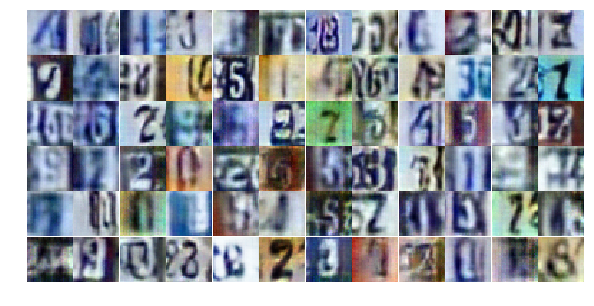

Epoch 14/25... Discriminator Loss: 0.7623... Generator Loss: 1.0778
Epoch 14/25... Discriminator Loss: 1.0171... Generator Loss: 0.6358
Epoch 14/25... Discriminator Loss: 0.7459... Generator Loss: 0.9461
Epoch 14/25... Discriminator Loss: 1.0391... Generator Loss: 0.5848
Epoch 14/25... Discriminator Loss: 0.5072... Generator Loss: 1.4235
Epoch 14/25... Discriminator Loss: 0.5203... Generator Loss: 1.1562
Epoch 14/25... Discriminator Loss: 0.6548... Generator Loss: 2.0771
Epoch 14/25... Discriminator Loss: 1.5255... Generator Loss: 0.4126
Epoch 14/25... Discriminator Loss: 0.8701... Generator Loss: 0.8964
Epoch 14/25... Discriminator Loss: 0.7118... Generator Loss: 0.9631


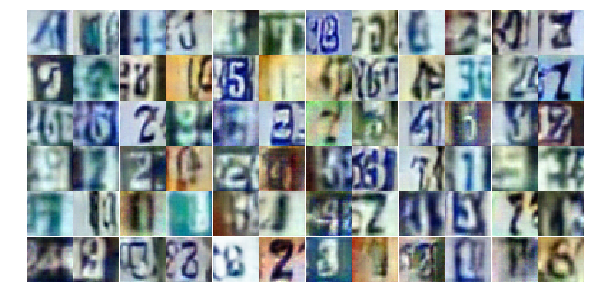

Epoch 14/25... Discriminator Loss: 0.9578... Generator Loss: 0.7364
Epoch 14/25... Discriminator Loss: 1.0454... Generator Loss: 0.6184
Epoch 15/25... Discriminator Loss: 0.7940... Generator Loss: 0.8330
Epoch 15/25... Discriminator Loss: 0.4346... Generator Loss: 1.5589
Epoch 15/25... Discriminator Loss: 0.5612... Generator Loss: 1.3843
Epoch 15/25... Discriminator Loss: 0.9051... Generator Loss: 0.7744
Epoch 15/25... Discriminator Loss: 0.8883... Generator Loss: 0.7328
Epoch 15/25... Discriminator Loss: 0.5379... Generator Loss: 1.5267
Epoch 15/25... Discriminator Loss: 1.5340... Generator Loss: 0.3377
Epoch 15/25... Discriminator Loss: 0.8144... Generator Loss: 0.8445


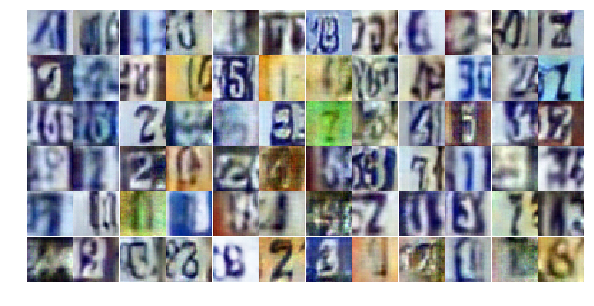

Epoch 15/25... Discriminator Loss: 0.7696... Generator Loss: 0.9000
Epoch 15/25... Discriminator Loss: 0.5569... Generator Loss: 2.5607
Epoch 15/25... Discriminator Loss: 0.6841... Generator Loss: 1.1941
Epoch 15/25... Discriminator Loss: 0.7934... Generator Loss: 0.8609
Epoch 15/25... Discriminator Loss: 0.8825... Generator Loss: 0.7554
Epoch 15/25... Discriminator Loss: 0.5164... Generator Loss: 1.3069
Epoch 15/25... Discriminator Loss: 0.9266... Generator Loss: 0.6844
Epoch 15/25... Discriminator Loss: 0.7211... Generator Loss: 1.0238
Epoch 15/25... Discriminator Loss: 0.6560... Generator Loss: 3.0533
Epoch 15/25... Discriminator Loss: 1.2614... Generator Loss: 0.5371


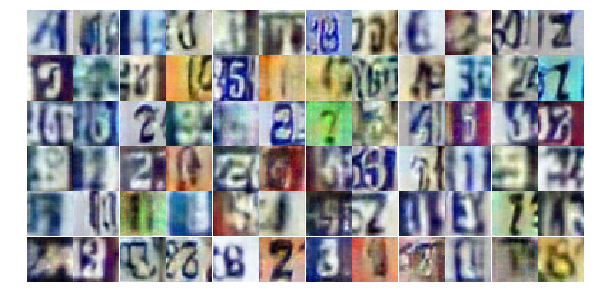

Epoch 15/25... Discriminator Loss: 0.8724... Generator Loss: 0.8104
Epoch 15/25... Discriminator Loss: 0.5931... Generator Loss: 1.1682
Epoch 15/25... Discriminator Loss: 0.4152... Generator Loss: 1.7277
Epoch 15/25... Discriminator Loss: 0.7654... Generator Loss: 0.9732
Epoch 15/25... Discriminator Loss: 0.8245... Generator Loss: 1.0481
Epoch 15/25... Discriminator Loss: 0.5502... Generator Loss: 1.3122
Epoch 15/25... Discriminator Loss: 0.9818... Generator Loss: 0.6755
Epoch 15/25... Discriminator Loss: 0.6210... Generator Loss: 1.1803
Epoch 15/25... Discriminator Loss: 0.5802... Generator Loss: 1.0914
Epoch 15/25... Discriminator Loss: 1.2136... Generator Loss: 0.5167


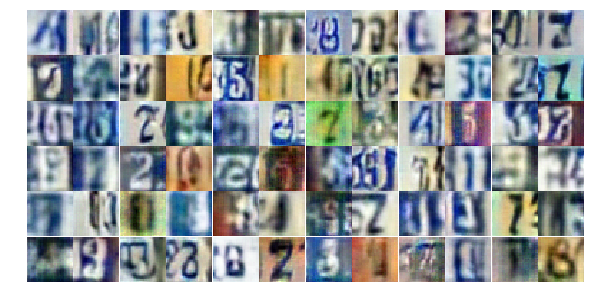

Epoch 15/25... Discriminator Loss: 0.6899... Generator Loss: 1.0628
Epoch 15/25... Discriminator Loss: 0.8068... Generator Loss: 0.8401
Epoch 15/25... Discriminator Loss: 0.3972... Generator Loss: 1.5701
Epoch 15/25... Discriminator Loss: 0.6617... Generator Loss: 1.3293
Epoch 15/25... Discriminator Loss: 0.6262... Generator Loss: 1.0360
Epoch 15/25... Discriminator Loss: 1.1432... Generator Loss: 3.2476
Epoch 15/25... Discriminator Loss: 0.8763... Generator Loss: 0.7539
Epoch 15/25... Discriminator Loss: 0.5696... Generator Loss: 1.2666
Epoch 15/25... Discriminator Loss: 0.5752... Generator Loss: 1.1644
Epoch 15/25... Discriminator Loss: 0.5520... Generator Loss: 1.5002


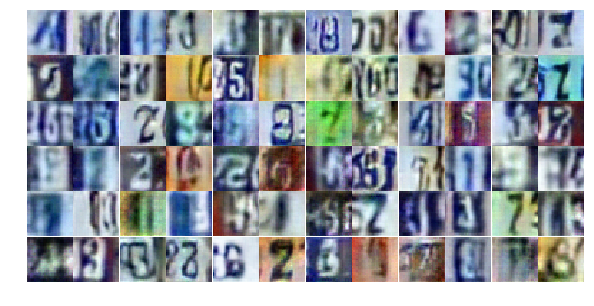

Epoch 15/25... Discriminator Loss: 0.5581... Generator Loss: 1.2518
Epoch 15/25... Discriminator Loss: 1.3370... Generator Loss: 0.4079
Epoch 15/25... Discriminator Loss: 0.5278... Generator Loss: 1.3203
Epoch 15/25... Discriminator Loss: 0.4489... Generator Loss: 1.4304
Epoch 15/25... Discriminator Loss: 0.4621... Generator Loss: 1.4751
Epoch 15/25... Discriminator Loss: 2.3173... Generator Loss: 0.1730
Epoch 15/25... Discriminator Loss: 0.4986... Generator Loss: 2.0548
Epoch 15/25... Discriminator Loss: 1.6882... Generator Loss: 3.5661
Epoch 15/25... Discriminator Loss: 1.3048... Generator Loss: 0.4701
Epoch 15/25... Discriminator Loss: 0.7241... Generator Loss: 1.5502


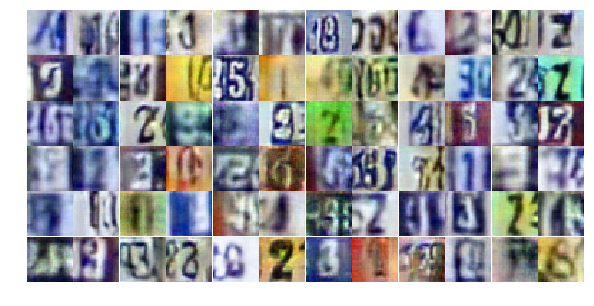

Epoch 15/25... Discriminator Loss: 0.9151... Generator Loss: 0.7064
Epoch 15/25... Discriminator Loss: 0.9331... Generator Loss: 0.7376
Epoch 15/25... Discriminator Loss: 0.4988... Generator Loss: 1.2458
Epoch 15/25... Discriminator Loss: 0.7899... Generator Loss: 0.9553
Epoch 15/25... Discriminator Loss: 0.4686... Generator Loss: 1.3936
Epoch 15/25... Discriminator Loss: 0.9720... Generator Loss: 2.3024
Epoch 15/25... Discriminator Loss: 0.7211... Generator Loss: 1.0889
Epoch 15/25... Discriminator Loss: 0.4918... Generator Loss: 1.4930
Epoch 15/25... Discriminator Loss: 1.4896... Generator Loss: 0.3785
Epoch 16/25... Discriminator Loss: 1.1465... Generator Loss: 0.5804


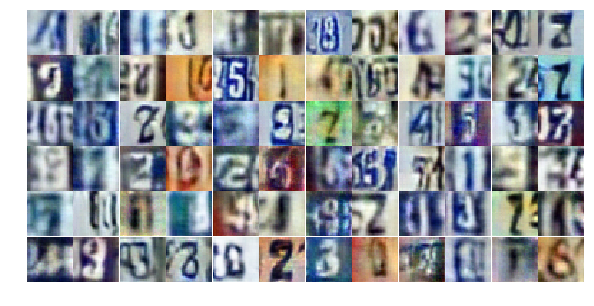

Epoch 16/25... Discriminator Loss: 0.5806... Generator Loss: 1.1261
Epoch 16/25... Discriminator Loss: 0.8030... Generator Loss: 0.8006
Epoch 16/25... Discriminator Loss: 1.2123... Generator Loss: 0.4551
Epoch 16/25... Discriminator Loss: 0.5592... Generator Loss: 1.6666
Epoch 16/25... Discriminator Loss: 0.5566... Generator Loss: 1.8410
Epoch 16/25... Discriminator Loss: 0.5761... Generator Loss: 1.9581
Epoch 16/25... Discriminator Loss: 1.8581... Generator Loss: 0.2462
Epoch 16/25... Discriminator Loss: 0.9075... Generator Loss: 0.7127
Epoch 16/25... Discriminator Loss: 0.7110... Generator Loss: 1.0017
Epoch 16/25... Discriminator Loss: 0.4589... Generator Loss: 1.4354


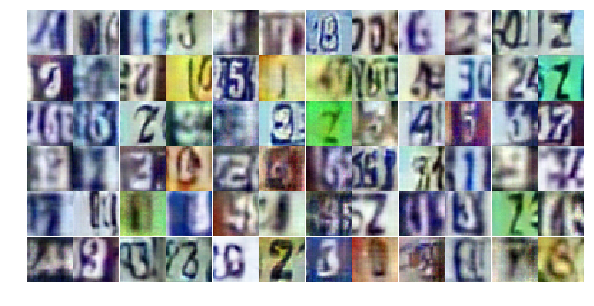

Epoch 16/25... Discriminator Loss: 1.3437... Generator Loss: 0.4585
Epoch 16/25... Discriminator Loss: 0.5253... Generator Loss: 1.5154
Epoch 16/25... Discriminator Loss: 0.6077... Generator Loss: 1.1671
Epoch 16/25... Discriminator Loss: 1.3360... Generator Loss: 0.4021
Epoch 16/25... Discriminator Loss: 0.6061... Generator Loss: 1.3395
Epoch 16/25... Discriminator Loss: 1.2755... Generator Loss: 0.4776
Epoch 16/25... Discriminator Loss: 1.0179... Generator Loss: 0.7124
Epoch 16/25... Discriminator Loss: 0.4277... Generator Loss: 1.6086
Epoch 16/25... Discriminator Loss: 0.5690... Generator Loss: 1.2295
Epoch 16/25... Discriminator Loss: 0.5601... Generator Loss: 1.3345


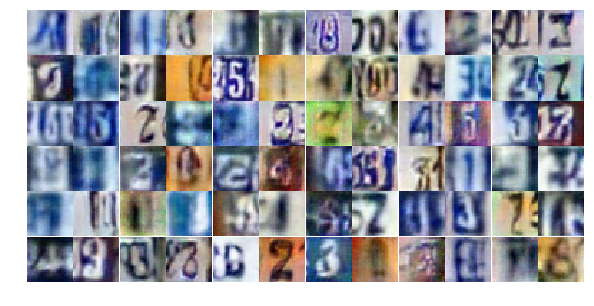

Epoch 16/25... Discriminator Loss: 0.5471... Generator Loss: 1.2657
Epoch 16/25... Discriminator Loss: 0.7199... Generator Loss: 0.9374
Epoch 16/25... Discriminator Loss: 0.7746... Generator Loss: 0.9641
Epoch 16/25... Discriminator Loss: 1.3453... Generator Loss: 0.4382
Epoch 16/25... Discriminator Loss: 0.6705... Generator Loss: 1.1366
Epoch 16/25... Discriminator Loss: 0.7963... Generator Loss: 0.8580
Epoch 16/25... Discriminator Loss: 0.6943... Generator Loss: 1.1792
Epoch 16/25... Discriminator Loss: 0.6759... Generator Loss: 1.0707
Epoch 16/25... Discriminator Loss: 0.9025... Generator Loss: 0.8022
Epoch 16/25... Discriminator Loss: 0.6165... Generator Loss: 1.1476


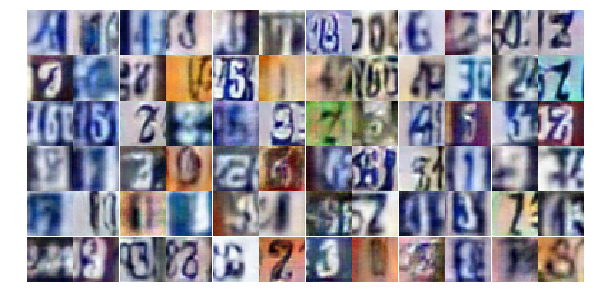

Epoch 16/25... Discriminator Loss: 1.1889... Generator Loss: 0.5149
Epoch 16/25... Discriminator Loss: 0.5480... Generator Loss: 1.1612
Epoch 16/25... Discriminator Loss: 0.5301... Generator Loss: 1.5092
Epoch 16/25... Discriminator Loss: 0.7175... Generator Loss: 1.1345
Epoch 16/25... Discriminator Loss: 1.4810... Generator Loss: 3.1138
Epoch 16/25... Discriminator Loss: 0.8647... Generator Loss: 0.8919
Epoch 16/25... Discriminator Loss: 1.3078... Generator Loss: 0.4719
Epoch 16/25... Discriminator Loss: 0.6137... Generator Loss: 1.2890
Epoch 16/25... Discriminator Loss: 0.8036... Generator Loss: 0.9044
Epoch 16/25... Discriminator Loss: 0.3985... Generator Loss: 1.7075


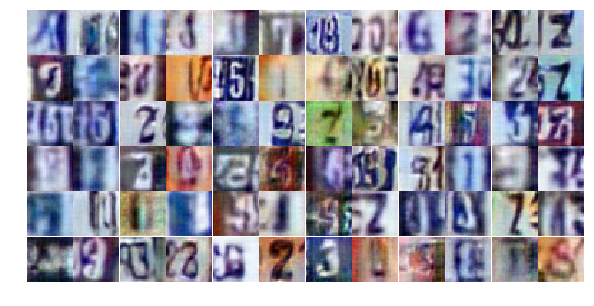

Epoch 16/25... Discriminator Loss: 0.5820... Generator Loss: 1.1210
Epoch 16/25... Discriminator Loss: 0.7789... Generator Loss: 0.9519
Epoch 16/25... Discriminator Loss: 1.0674... Generator Loss: 0.6583
Epoch 16/25... Discriminator Loss: 1.3780... Generator Loss: 2.9758
Epoch 16/25... Discriminator Loss: 1.0012... Generator Loss: 0.7632
Epoch 16/25... Discriminator Loss: 1.0205... Generator Loss: 0.6317
Epoch 16/25... Discriminator Loss: 0.5181... Generator Loss: 2.1182
Epoch 16/25... Discriminator Loss: 0.7062... Generator Loss: 1.0508
Epoch 16/25... Discriminator Loss: 0.5098... Generator Loss: 1.2383
Epoch 16/25... Discriminator Loss: 0.7902... Generator Loss: 0.9829


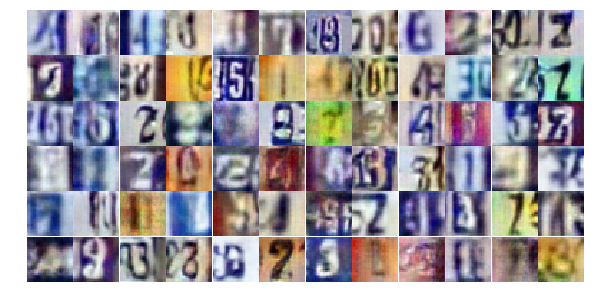

Epoch 16/25... Discriminator Loss: 1.5351... Generator Loss: 0.3887
Epoch 16/25... Discriminator Loss: 0.5218... Generator Loss: 1.4408
Epoch 16/25... Discriminator Loss: 2.3436... Generator Loss: 0.1726
Epoch 16/25... Discriminator Loss: 0.5184... Generator Loss: 3.0848
Epoch 16/25... Discriminator Loss: 0.4989... Generator Loss: 1.5995
Epoch 16/25... Discriminator Loss: 0.6876... Generator Loss: 1.0131
Epoch 17/25... Discriminator Loss: 0.8366... Generator Loss: 0.7930
Epoch 17/25... Discriminator Loss: 1.2245... Generator Loss: 0.4790
Epoch 17/25... Discriminator Loss: 0.7063... Generator Loss: 1.0056
Epoch 17/25... Discriminator Loss: 0.5774... Generator Loss: 1.1907


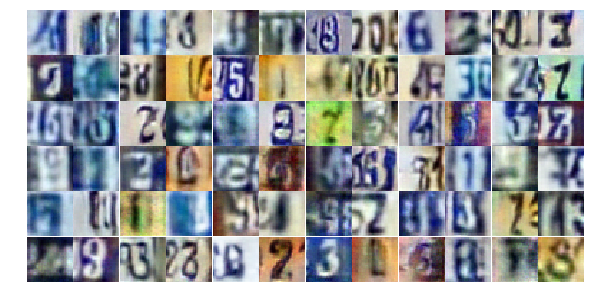

Epoch 17/25... Discriminator Loss: 0.4727... Generator Loss: 1.4856
Epoch 17/25... Discriminator Loss: 0.7008... Generator Loss: 1.0772
Epoch 17/25... Discriminator Loss: 0.7483... Generator Loss: 1.0065
Epoch 17/25... Discriminator Loss: 0.6060... Generator Loss: 1.4936
Epoch 17/25... Discriminator Loss: 1.0594... Generator Loss: 0.6721
Epoch 17/25... Discriminator Loss: 1.0131... Generator Loss: 0.6717
Epoch 17/25... Discriminator Loss: 0.8678... Generator Loss: 0.7804
Epoch 17/25... Discriminator Loss: 0.7796... Generator Loss: 0.8609
Epoch 17/25... Discriminator Loss: 0.4303... Generator Loss: 1.4745
Epoch 17/25... Discriminator Loss: 0.6622... Generator Loss: 1.9044


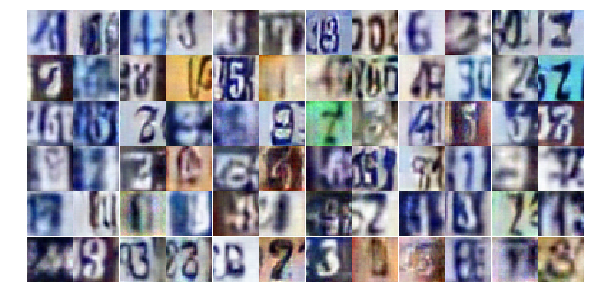

Epoch 17/25... Discriminator Loss: 0.9294... Generator Loss: 0.7225
Epoch 17/25... Discriminator Loss: 0.6946... Generator Loss: 1.0466
Epoch 17/25... Discriminator Loss: 0.6040... Generator Loss: 1.4090
Epoch 17/25... Discriminator Loss: 1.2529... Generator Loss: 0.5199
Epoch 17/25... Discriminator Loss: 0.6618... Generator Loss: 1.4722
Epoch 17/25... Discriminator Loss: 0.7601... Generator Loss: 0.8809
Epoch 17/25... Discriminator Loss: 0.5609... Generator Loss: 1.8504
Epoch 17/25... Discriminator Loss: 0.5833... Generator Loss: 1.1891
Epoch 17/25... Discriminator Loss: 0.8287... Generator Loss: 0.8988
Epoch 17/25... Discriminator Loss: 0.6695... Generator Loss: 0.9889


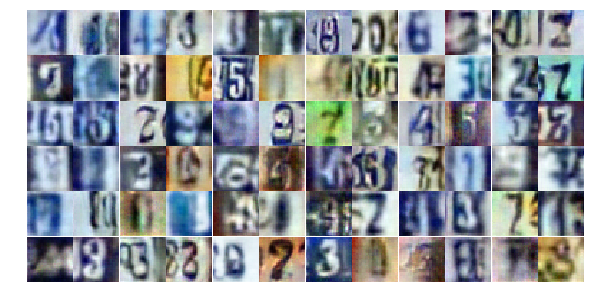

Epoch 17/25... Discriminator Loss: 1.4840... Generator Loss: 0.3912
Epoch 17/25... Discriminator Loss: 0.4699... Generator Loss: 1.5597
Epoch 17/25... Discriminator Loss: 0.4807... Generator Loss: 1.2719
Epoch 17/25... Discriminator Loss: 1.2209... Generator Loss: 0.4844
Epoch 17/25... Discriminator Loss: 1.7190... Generator Loss: 0.3195
Epoch 17/25... Discriminator Loss: 0.4928... Generator Loss: 1.4359
Epoch 17/25... Discriminator Loss: 0.7515... Generator Loss: 0.9397
Epoch 17/25... Discriminator Loss: 0.8788... Generator Loss: 0.7772
Epoch 17/25... Discriminator Loss: 0.8458... Generator Loss: 0.7970
Epoch 17/25... Discriminator Loss: 0.3928... Generator Loss: 1.6958


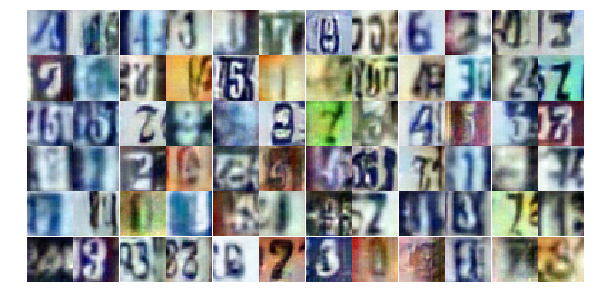

Epoch 17/25... Discriminator Loss: 0.9411... Generator Loss: 0.7058
Epoch 17/25... Discriminator Loss: 0.8695... Generator Loss: 0.9212
Epoch 17/25... Discriminator Loss: 0.6127... Generator Loss: 1.1022
Epoch 17/25... Discriminator Loss: 0.8351... Generator Loss: 0.8798
Epoch 17/25... Discriminator Loss: 1.0304... Generator Loss: 0.6556
Epoch 17/25... Discriminator Loss: 0.5354... Generator Loss: 1.2160
Epoch 17/25... Discriminator Loss: 0.6609... Generator Loss: 2.1998
Epoch 17/25... Discriminator Loss: 0.5554... Generator Loss: 1.3094
Epoch 17/25... Discriminator Loss: 0.4541... Generator Loss: 1.7277
Epoch 17/25... Discriminator Loss: 0.7757... Generator Loss: 0.8447


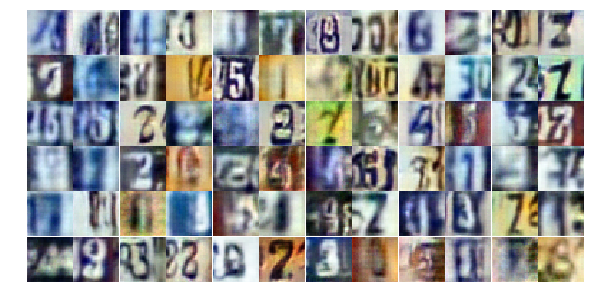

Epoch 17/25... Discriminator Loss: 1.8645... Generator Loss: 0.2763
Epoch 17/25... Discriminator Loss: 0.2897... Generator Loss: 2.0620
Epoch 17/25... Discriminator Loss: 0.8643... Generator Loss: 1.1246
Epoch 17/25... Discriminator Loss: 0.2916... Generator Loss: 2.1871
Epoch 17/25... Discriminator Loss: 0.9741... Generator Loss: 0.7159
Epoch 17/25... Discriminator Loss: 0.9141... Generator Loss: 0.7034
Epoch 17/25... Discriminator Loss: 0.9866... Generator Loss: 0.7014
Epoch 17/25... Discriminator Loss: 0.4360... Generator Loss: 1.5650
Epoch 17/25... Discriminator Loss: 0.6542... Generator Loss: 1.3895
Epoch 17/25... Discriminator Loss: 1.4924... Generator Loss: 0.4351


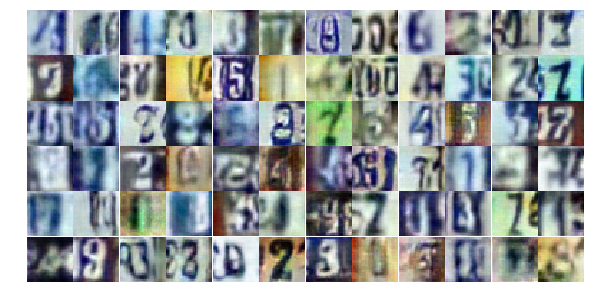

Epoch 17/25... Discriminator Loss: 0.6085... Generator Loss: 1.4872
Epoch 17/25... Discriminator Loss: 0.7116... Generator Loss: 1.2790
Epoch 17/25... Discriminator Loss: 0.5071... Generator Loss: 1.5281
Epoch 17/25... Discriminator Loss: 0.7767... Generator Loss: 0.9819
Epoch 18/25... Discriminator Loss: 1.0367... Generator Loss: 0.6087
Epoch 18/25... Discriminator Loss: 0.9902... Generator Loss: 0.6619
Epoch 18/25... Discriminator Loss: 1.2363... Generator Loss: 0.4881
Epoch 18/25... Discriminator Loss: 0.6498... Generator Loss: 1.1472
Epoch 18/25... Discriminator Loss: 1.3261... Generator Loss: 0.3962
Epoch 18/25... Discriminator Loss: 0.6119... Generator Loss: 1.1692


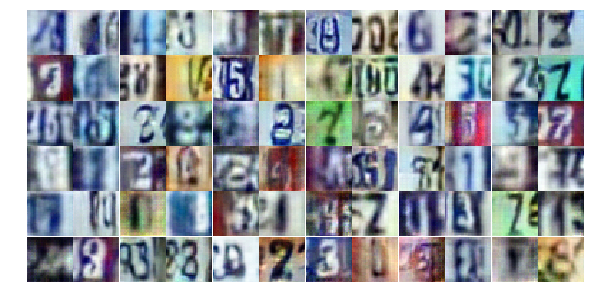

Epoch 18/25... Discriminator Loss: 2.0374... Generator Loss: 4.5413
Epoch 18/25... Discriminator Loss: 1.3069... Generator Loss: 0.5656
Epoch 18/25... Discriminator Loss: 1.0447... Generator Loss: 0.6077
Epoch 18/25... Discriminator Loss: 0.4952... Generator Loss: 1.6491
Epoch 18/25... Discriminator Loss: 0.7190... Generator Loss: 0.9286
Epoch 18/25... Discriminator Loss: 1.0426... Generator Loss: 0.6779
Epoch 18/25... Discriminator Loss: 0.8921... Generator Loss: 0.7659
Epoch 18/25... Discriminator Loss: 0.7998... Generator Loss: 0.8563
Epoch 18/25... Discriminator Loss: 0.5625... Generator Loss: 2.1420
Epoch 18/25... Discriminator Loss: 0.3184... Generator Loss: 2.3731


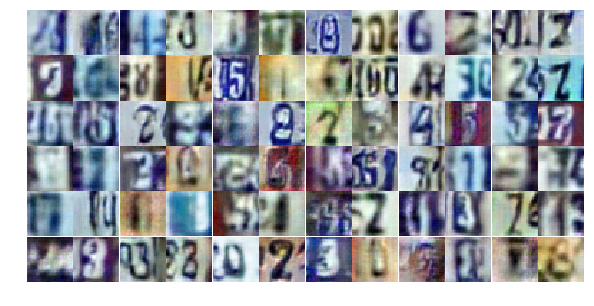

Epoch 18/25... Discriminator Loss: 0.6125... Generator Loss: 1.7790
Epoch 18/25... Discriminator Loss: 0.7324... Generator Loss: 0.9774
Epoch 18/25... Discriminator Loss: 1.0185... Generator Loss: 0.6688
Epoch 18/25... Discriminator Loss: 0.4472... Generator Loss: 1.4830
Epoch 18/25... Discriminator Loss: 0.6683... Generator Loss: 0.9814
Epoch 18/25... Discriminator Loss: 1.2898... Generator Loss: 0.4577
Epoch 18/25... Discriminator Loss: 0.7195... Generator Loss: 1.2592
Epoch 18/25... Discriminator Loss: 0.7922... Generator Loss: 0.8534
Epoch 18/25... Discriminator Loss: 0.7250... Generator Loss: 0.9658
Epoch 18/25... Discriminator Loss: 0.5561... Generator Loss: 1.4205


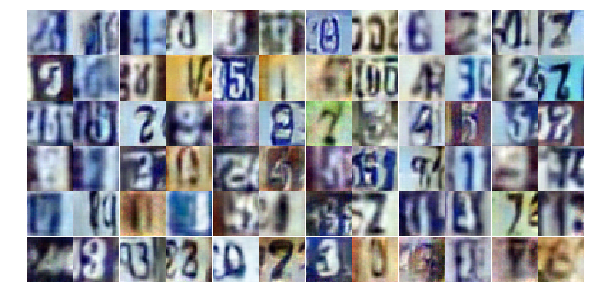

Epoch 18/25... Discriminator Loss: 0.4453... Generator Loss: 1.4664
Epoch 18/25... Discriminator Loss: 0.6811... Generator Loss: 1.0820
Epoch 18/25... Discriminator Loss: 0.9835... Generator Loss: 0.7017
Epoch 18/25... Discriminator Loss: 0.7852... Generator Loss: 0.9761
Epoch 18/25... Discriminator Loss: 0.8011... Generator Loss: 0.8264
Epoch 18/25... Discriminator Loss: 0.5170... Generator Loss: 1.2918
Epoch 18/25... Discriminator Loss: 0.7226... Generator Loss: 0.9326
Epoch 18/25... Discriminator Loss: 0.4685... Generator Loss: 1.5811
Epoch 18/25... Discriminator Loss: 0.6882... Generator Loss: 1.2365
Epoch 18/25... Discriminator Loss: 0.7847... Generator Loss: 0.9320


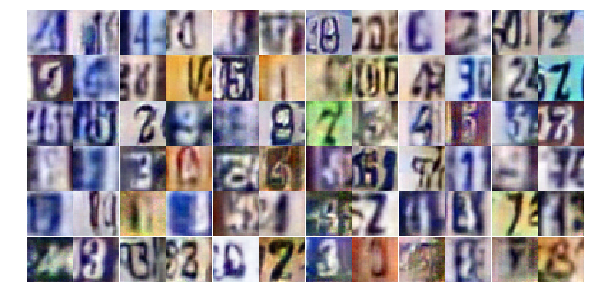

Epoch 18/25... Discriminator Loss: 0.8384... Generator Loss: 0.8378
Epoch 18/25... Discriminator Loss: 0.8033... Generator Loss: 0.8568
Epoch 18/25... Discriminator Loss: 0.5690... Generator Loss: 1.1197
Epoch 18/25... Discriminator Loss: 0.6734... Generator Loss: 0.9361
Epoch 18/25... Discriminator Loss: 0.7932... Generator Loss: 0.9790
Epoch 18/25... Discriminator Loss: 0.5822... Generator Loss: 1.0693
Epoch 18/25... Discriminator Loss: 0.8540... Generator Loss: 0.8018
Epoch 18/25... Discriminator Loss: 0.9178... Generator Loss: 2.0905
Epoch 18/25... Discriminator Loss: 0.8487... Generator Loss: 0.7552
Epoch 18/25... Discriminator Loss: 0.4261... Generator Loss: 2.2712


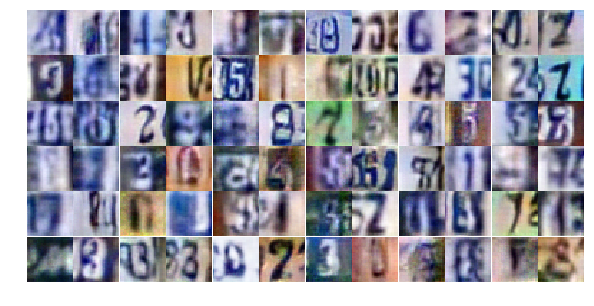

Epoch 18/25... Discriminator Loss: 0.6486... Generator Loss: 1.0767
Epoch 18/25... Discriminator Loss: 0.7450... Generator Loss: 0.9672
Epoch 18/25... Discriminator Loss: 0.6528... Generator Loss: 1.0290
Epoch 18/25... Discriminator Loss: 0.7958... Generator Loss: 0.9142
Epoch 18/25... Discriminator Loss: 0.5970... Generator Loss: 1.1279
Epoch 18/25... Discriminator Loss: 0.6366... Generator Loss: 1.1602
Epoch 18/25... Discriminator Loss: 0.7001... Generator Loss: 0.9846
Epoch 18/25... Discriminator Loss: 0.6671... Generator Loss: 1.7639
Epoch 18/25... Discriminator Loss: 1.0799... Generator Loss: 0.7750
Epoch 18/25... Discriminator Loss: 1.5682... Generator Loss: 0.4069


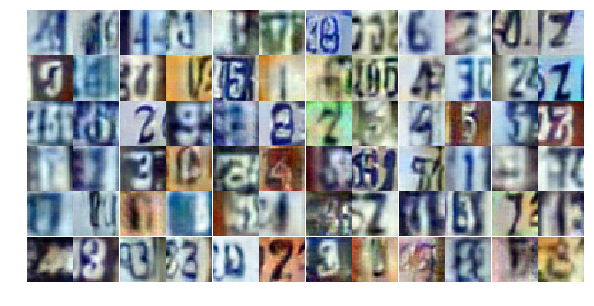

Epoch 18/25... Discriminator Loss: 0.6573... Generator Loss: 1.3563
Epoch 19/25... Discriminator Loss: 1.1611... Generator Loss: 0.5116
Epoch 19/25... Discriminator Loss: 1.0669... Generator Loss: 0.6404
Epoch 19/25... Discriminator Loss: 0.6761... Generator Loss: 1.0525
Epoch 19/25... Discriminator Loss: 0.6589... Generator Loss: 0.9923
Epoch 19/25... Discriminator Loss: 0.9375... Generator Loss: 0.8030
Epoch 19/25... Discriminator Loss: 0.3747... Generator Loss: 2.0488
Epoch 19/25... Discriminator Loss: 0.8011... Generator Loss: 0.9518
Epoch 19/25... Discriminator Loss: 0.7822... Generator Loss: 3.1407
Epoch 19/25... Discriminator Loss: 1.1268... Generator Loss: 0.6157


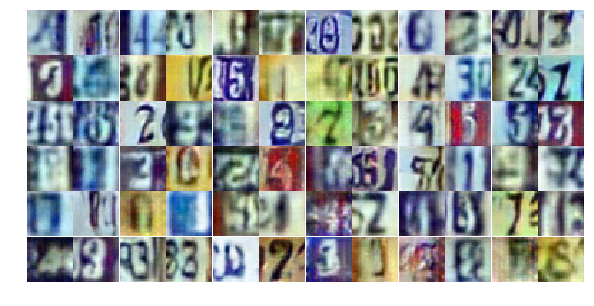

Epoch 19/25... Discriminator Loss: 0.6480... Generator Loss: 1.0723
Epoch 19/25... Discriminator Loss: 0.8586... Generator Loss: 0.7450
Epoch 19/25... Discriminator Loss: 0.6783... Generator Loss: 1.1609
Epoch 19/25... Discriminator Loss: 1.0517... Generator Loss: 0.5959
Epoch 19/25... Discriminator Loss: 0.9700... Generator Loss: 0.6531
Epoch 19/25... Discriminator Loss: 0.8420... Generator Loss: 1.1119
Epoch 19/25... Discriminator Loss: 0.7386... Generator Loss: 0.9237
Epoch 19/25... Discriminator Loss: 0.6357... Generator Loss: 1.1779
Epoch 19/25... Discriminator Loss: 1.1620... Generator Loss: 2.6763
Epoch 19/25... Discriminator Loss: 1.3154... Generator Loss: 0.4874


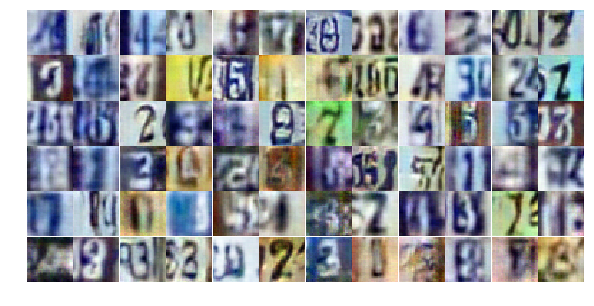

Epoch 19/25... Discriminator Loss: 0.7544... Generator Loss: 0.9232
Epoch 19/25... Discriminator Loss: 0.9404... Generator Loss: 0.8778
Epoch 19/25... Discriminator Loss: 1.1253... Generator Loss: 0.5924
Epoch 19/25... Discriminator Loss: 0.7241... Generator Loss: 1.3037
Epoch 19/25... Discriminator Loss: 0.8451... Generator Loss: 0.8654
Epoch 19/25... Discriminator Loss: 0.7966... Generator Loss: 1.0743
Epoch 19/25... Discriminator Loss: 0.5038... Generator Loss: 1.3699
Epoch 19/25... Discriminator Loss: 0.4904... Generator Loss: 1.4637
Epoch 19/25... Discriminator Loss: 0.4743... Generator Loss: 1.4656
Epoch 19/25... Discriminator Loss: 1.0981... Generator Loss: 0.6338


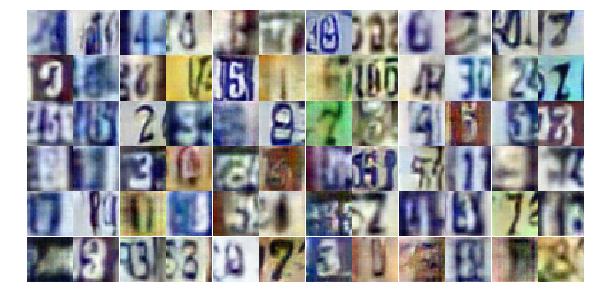

Epoch 19/25... Discriminator Loss: 0.7446... Generator Loss: 1.0016
Epoch 19/25... Discriminator Loss: 0.7786... Generator Loss: 0.8448
Epoch 19/25... Discriminator Loss: 1.0306... Generator Loss: 0.5959
Epoch 19/25... Discriminator Loss: 0.6291... Generator Loss: 1.0225
Epoch 19/25... Discriminator Loss: 0.6320... Generator Loss: 1.1976
Epoch 19/25... Discriminator Loss: 1.0839... Generator Loss: 0.6083
Epoch 19/25... Discriminator Loss: 0.6968... Generator Loss: 1.6428
Epoch 19/25... Discriminator Loss: 0.7090... Generator Loss: 1.0800
Epoch 19/25... Discriminator Loss: 0.8858... Generator Loss: 0.7888
Epoch 19/25... Discriminator Loss: 0.5456... Generator Loss: 1.1992


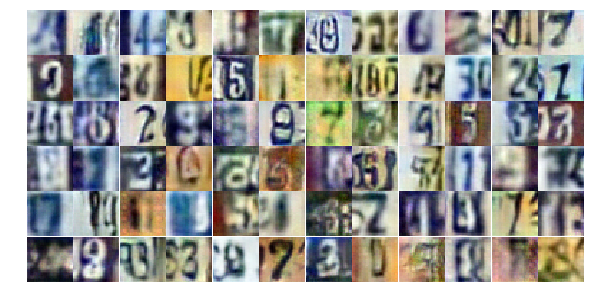

Epoch 19/25... Discriminator Loss: 0.5508... Generator Loss: 1.1230
Epoch 19/25... Discriminator Loss: 0.6451... Generator Loss: 1.1694
Epoch 19/25... Discriminator Loss: 1.2175... Generator Loss: 0.4883
Epoch 19/25... Discriminator Loss: 0.6372... Generator Loss: 1.0440
Epoch 19/25... Discriminator Loss: 0.7647... Generator Loss: 1.0619
Epoch 19/25... Discriminator Loss: 2.4094... Generator Loss: 0.4786
Epoch 19/25... Discriminator Loss: 2.7901... Generator Loss: 4.8912
Epoch 19/25... Discriminator Loss: 0.5866... Generator Loss: 1.5991
Epoch 19/25... Discriminator Loss: 0.8102... Generator Loss: 0.8617
Epoch 19/25... Discriminator Loss: 0.8916... Generator Loss: 0.8431


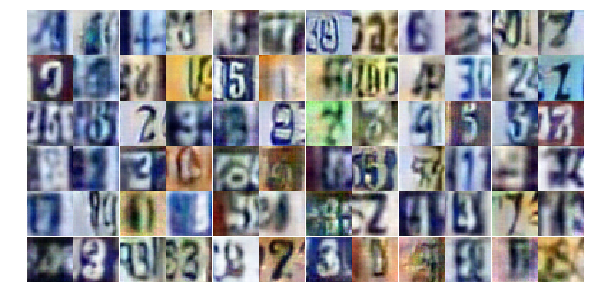

Epoch 19/25... Discriminator Loss: 0.8300... Generator Loss: 0.8122
Epoch 19/25... Discriminator Loss: 0.7091... Generator Loss: 1.1359
Epoch 19/25... Discriminator Loss: 0.5822... Generator Loss: 1.6974
Epoch 19/25... Discriminator Loss: 1.3359... Generator Loss: 0.4458
Epoch 19/25... Discriminator Loss: 1.1181... Generator Loss: 0.6526
Epoch 19/25... Discriminator Loss: 0.5549... Generator Loss: 1.2403
Epoch 19/25... Discriminator Loss: 1.7134... Generator Loss: 0.3009
Epoch 19/25... Discriminator Loss: 0.6647... Generator Loss: 0.9930
Epoch 20/25... Discriminator Loss: 0.6762... Generator Loss: 1.0826
Epoch 20/25... Discriminator Loss: 0.6974... Generator Loss: 1.0980


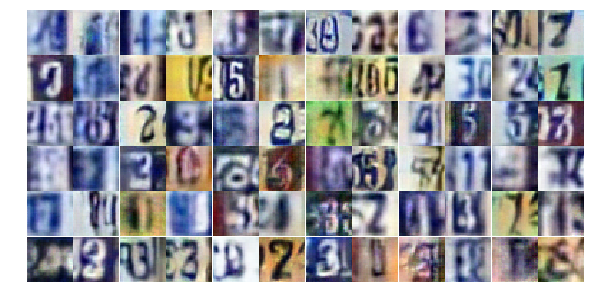

Epoch 20/25... Discriminator Loss: 0.6252... Generator Loss: 1.1674
Epoch 20/25... Discriminator Loss: 0.6431... Generator Loss: 1.2205
Epoch 20/25... Discriminator Loss: 1.0848... Generator Loss: 0.7096
Epoch 20/25... Discriminator Loss: 1.4963... Generator Loss: 0.4724
Epoch 20/25... Discriminator Loss: 0.5648... Generator Loss: 1.1410
Epoch 20/25... Discriminator Loss: 0.6955... Generator Loss: 1.1014
Epoch 20/25... Discriminator Loss: 0.9679... Generator Loss: 0.6812
Epoch 20/25... Discriminator Loss: 0.9692... Generator Loss: 0.6410
Epoch 20/25... Discriminator Loss: 0.9418... Generator Loss: 0.7558
Epoch 20/25... Discriminator Loss: 0.7808... Generator Loss: 0.8587


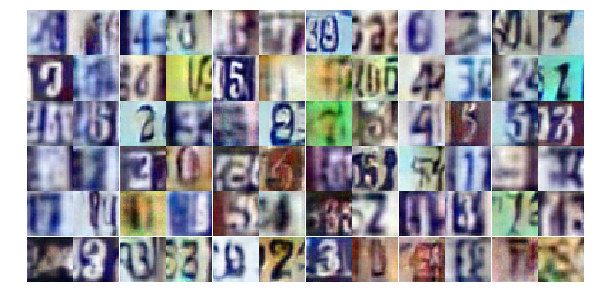

Epoch 20/25... Discriminator Loss: 1.2610... Generator Loss: 0.4731
Epoch 20/25... Discriminator Loss: 1.0968... Generator Loss: 0.5906
Epoch 20/25... Discriminator Loss: 0.7991... Generator Loss: 0.8727
Epoch 20/25... Discriminator Loss: 0.7052... Generator Loss: 1.5309
Epoch 20/25... Discriminator Loss: 0.8031... Generator Loss: 0.8100
Epoch 20/25... Discriminator Loss: 1.5384... Generator Loss: 0.3480
Epoch 20/25... Discriminator Loss: 1.3285... Generator Loss: 0.4566
Epoch 20/25... Discriminator Loss: 0.7012... Generator Loss: 0.9317
Epoch 20/25... Discriminator Loss: 0.4557... Generator Loss: 1.5871
Epoch 20/25... Discriminator Loss: 1.0305... Generator Loss: 0.6631


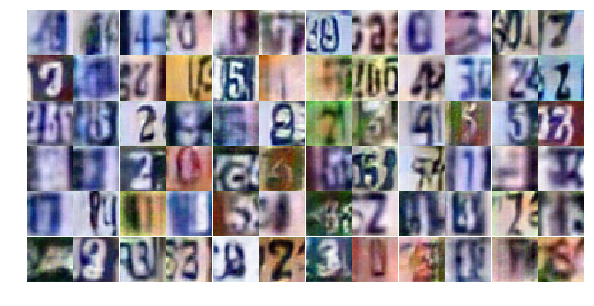

Epoch 20/25... Discriminator Loss: 0.6350... Generator Loss: 1.1251
Epoch 20/25... Discriminator Loss: 1.0482... Generator Loss: 0.6559
Epoch 20/25... Discriminator Loss: 0.3045... Generator Loss: 2.4476
Epoch 20/25... Discriminator Loss: 1.3921... Generator Loss: 0.4052
Epoch 20/25... Discriminator Loss: 0.8195... Generator Loss: 1.0273
Epoch 20/25... Discriminator Loss: 0.6073... Generator Loss: 1.0693
Epoch 20/25... Discriminator Loss: 0.6236... Generator Loss: 1.8957
Epoch 20/25... Discriminator Loss: 2.0237... Generator Loss: 0.1956
Epoch 20/25... Discriminator Loss: 0.8017... Generator Loss: 1.1649
Epoch 20/25... Discriminator Loss: 0.6964... Generator Loss: 0.9417


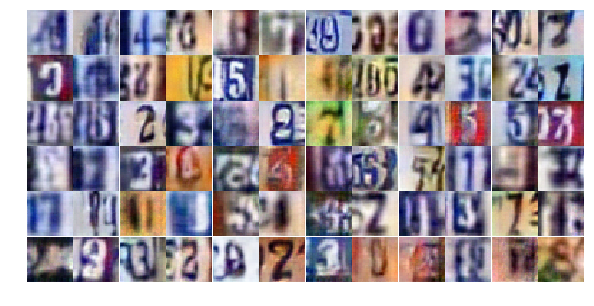

Epoch 20/25... Discriminator Loss: 1.0595... Generator Loss: 0.6371
Epoch 20/25... Discriminator Loss: 0.4617... Generator Loss: 1.3463
Epoch 20/25... Discriminator Loss: 1.3051... Generator Loss: 0.6520
Epoch 20/25... Discriminator Loss: 0.6896... Generator Loss: 1.0203
Epoch 20/25... Discriminator Loss: 0.7804... Generator Loss: 0.9800
Epoch 20/25... Discriminator Loss: 0.5560... Generator Loss: 1.3253
Epoch 20/25... Discriminator Loss: 0.7030... Generator Loss: 1.2451
Epoch 20/25... Discriminator Loss: 0.9781... Generator Loss: 0.6853
Epoch 20/25... Discriminator Loss: 0.5830... Generator Loss: 1.4692
Epoch 20/25... Discriminator Loss: 0.8347... Generator Loss: 0.8370


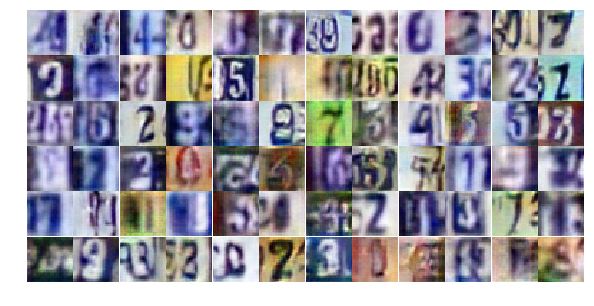

Epoch 20/25... Discriminator Loss: 0.6773... Generator Loss: 0.9820
Epoch 20/25... Discriminator Loss: 0.7806... Generator Loss: 0.9112
Epoch 20/25... Discriminator Loss: 1.8809... Generator Loss: 0.3501
Epoch 20/25... Discriminator Loss: 1.1211... Generator Loss: 0.6570
Epoch 20/25... Discriminator Loss: 0.8257... Generator Loss: 0.8424
Epoch 20/25... Discriminator Loss: 0.8347... Generator Loss: 0.8056
Epoch 20/25... Discriminator Loss: 1.0995... Generator Loss: 0.6323
Epoch 20/25... Discriminator Loss: 0.4427... Generator Loss: 1.6889
Epoch 20/25... Discriminator Loss: 0.6180... Generator Loss: 1.3073
Epoch 20/25... Discriminator Loss: 0.8569... Generator Loss: 0.8109


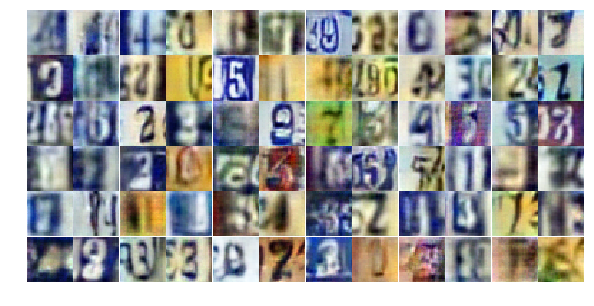

Epoch 20/25... Discriminator Loss: 0.5682... Generator Loss: 1.3208
Epoch 20/25... Discriminator Loss: 0.6286... Generator Loss: 1.7022
Epoch 20/25... Discriminator Loss: 0.4946... Generator Loss: 1.6652
Epoch 20/25... Discriminator Loss: 0.8377... Generator Loss: 0.9696
Epoch 20/25... Discriminator Loss: 0.9276... Generator Loss: 0.7255
Epoch 20/25... Discriminator Loss: 0.4944... Generator Loss: 1.3651
Epoch 21/25... Discriminator Loss: 0.9688... Generator Loss: 0.6865
Epoch 21/25... Discriminator Loss: 0.6873... Generator Loss: 1.0613
Epoch 21/25... Discriminator Loss: 1.2219... Generator Loss: 0.6731
Epoch 21/25... Discriminator Loss: 1.6108... Generator Loss: 0.2995


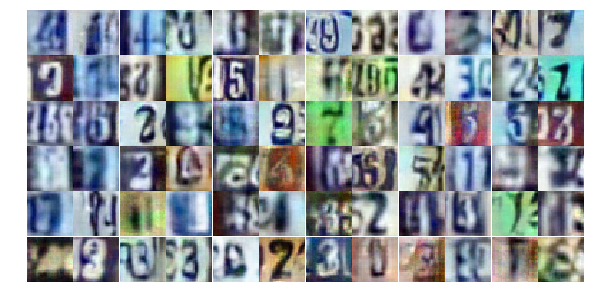

Epoch 21/25... Discriminator Loss: 0.8662... Generator Loss: 0.8125
Epoch 21/25... Discriminator Loss: 1.9018... Generator Loss: 0.2678
Epoch 21/25... Discriminator Loss: 0.4354... Generator Loss: 1.5365
Epoch 21/25... Discriminator Loss: 0.4407... Generator Loss: 1.4543
Epoch 21/25... Discriminator Loss: 1.0465... Generator Loss: 0.6381
Epoch 21/25... Discriminator Loss: 0.5505... Generator Loss: 1.1847
Epoch 21/25... Discriminator Loss: 0.6375... Generator Loss: 1.1333
Epoch 21/25... Discriminator Loss: 0.9895... Generator Loss: 0.7356
Epoch 21/25... Discriminator Loss: 0.6258... Generator Loss: 1.3918
Epoch 21/25... Discriminator Loss: 0.8572... Generator Loss: 0.7799


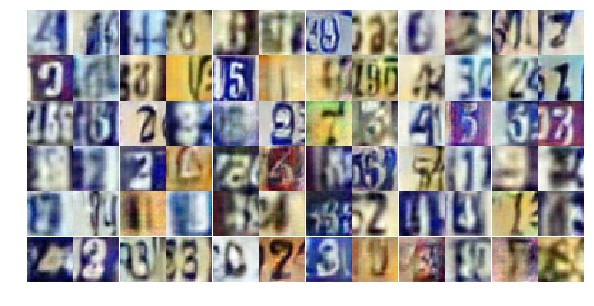

Epoch 21/25... Discriminator Loss: 0.3244... Generator Loss: 1.8814
Epoch 21/25... Discriminator Loss: 1.1406... Generator Loss: 0.5434
Epoch 21/25... Discriminator Loss: 1.3425... Generator Loss: 2.5987
Epoch 21/25... Discriminator Loss: 1.5822... Generator Loss: 0.3808
Epoch 21/25... Discriminator Loss: 0.8924... Generator Loss: 0.8528
Epoch 21/25... Discriminator Loss: 1.0842... Generator Loss: 0.6907
Epoch 21/25... Discriminator Loss: 0.9473... Generator Loss: 0.7639
Epoch 21/25... Discriminator Loss: 0.4410... Generator Loss: 1.6350
Epoch 21/25... Discriminator Loss: 0.5066... Generator Loss: 1.4342
Epoch 21/25... Discriminator Loss: 0.6652... Generator Loss: 1.1637


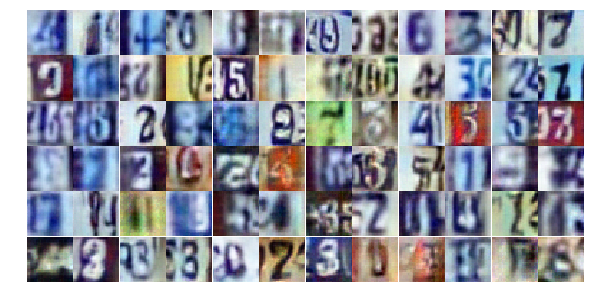

Epoch 21/25... Discriminator Loss: 1.2494... Generator Loss: 0.5270
Epoch 21/25... Discriminator Loss: 0.4904... Generator Loss: 1.3892
Epoch 21/25... Discriminator Loss: 1.1763... Generator Loss: 0.5703
Epoch 21/25... Discriminator Loss: 0.7087... Generator Loss: 1.1095
Epoch 21/25... Discriminator Loss: 0.9244... Generator Loss: 0.7245
Epoch 21/25... Discriminator Loss: 1.1963... Generator Loss: 0.5521
Epoch 21/25... Discriminator Loss: 0.4953... Generator Loss: 1.4056
Epoch 21/25... Discriminator Loss: 1.5763... Generator Loss: 0.3912
Epoch 21/25... Discriminator Loss: 1.2876... Generator Loss: 0.4835
Epoch 21/25... Discriminator Loss: 1.6930... Generator Loss: 0.3571


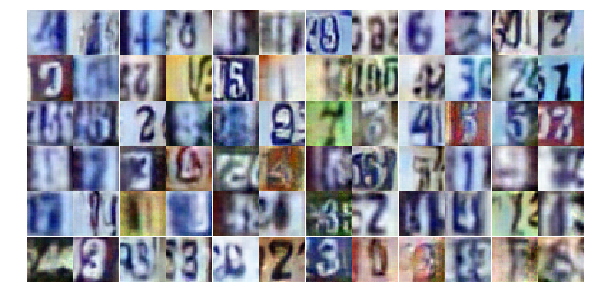

Epoch 21/25... Discriminator Loss: 1.3116... Generator Loss: 0.5143
Epoch 21/25... Discriminator Loss: 0.6251... Generator Loss: 1.1184
Epoch 21/25... Discriminator Loss: 1.0354... Generator Loss: 0.6152
Epoch 21/25... Discriminator Loss: 0.4953... Generator Loss: 1.3302
Epoch 21/25... Discriminator Loss: 0.6658... Generator Loss: 0.9960
Epoch 21/25... Discriminator Loss: 0.8825... Generator Loss: 0.7398
Epoch 21/25... Discriminator Loss: 0.7571... Generator Loss: 1.0049
Epoch 21/25... Discriminator Loss: 1.0964... Generator Loss: 0.6080
Epoch 21/25... Discriminator Loss: 0.8099... Generator Loss: 0.8026
Epoch 21/25... Discriminator Loss: 0.3560... Generator Loss: 2.7552


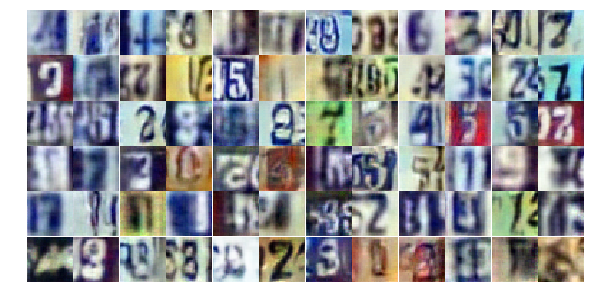

Epoch 21/25... Discriminator Loss: 0.5856... Generator Loss: 1.4201
Epoch 21/25... Discriminator Loss: 1.4482... Generator Loss: 0.4618
Epoch 21/25... Discriminator Loss: 0.5351... Generator Loss: 1.2826
Epoch 21/25... Discriminator Loss: 1.2087... Generator Loss: 0.5715
Epoch 21/25... Discriminator Loss: 0.3859... Generator Loss: 1.6121
Epoch 21/25... Discriminator Loss: 0.6682... Generator Loss: 1.2571
Epoch 21/25... Discriminator Loss: 0.6625... Generator Loss: 1.2263
Epoch 21/25... Discriminator Loss: 1.0735... Generator Loss: 0.5927
Epoch 21/25... Discriminator Loss: 1.0651... Generator Loss: 0.6675
Epoch 21/25... Discriminator Loss: 0.4560... Generator Loss: 1.3888


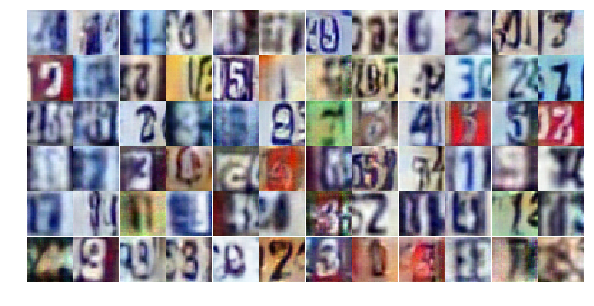

Epoch 21/25... Discriminator Loss: 0.5397... Generator Loss: 1.2258
Epoch 21/25... Discriminator Loss: 1.4636... Generator Loss: 0.4818
Epoch 21/25... Discriminator Loss: 0.6273... Generator Loss: 1.2431
Epoch 22/25... Discriminator Loss: 0.8459... Generator Loss: 0.9211
Epoch 22/25... Discriminator Loss: 0.8945... Generator Loss: 1.2631
Epoch 22/25... Discriminator Loss: 0.7332... Generator Loss: 1.0359
Epoch 22/25... Discriminator Loss: 0.4808... Generator Loss: 1.4750
Epoch 22/25... Discriminator Loss: 0.4172... Generator Loss: 1.6886
Epoch 22/25... Discriminator Loss: 0.9375... Generator Loss: 0.7701
Epoch 22/25... Discriminator Loss: 0.9387... Generator Loss: 0.7000


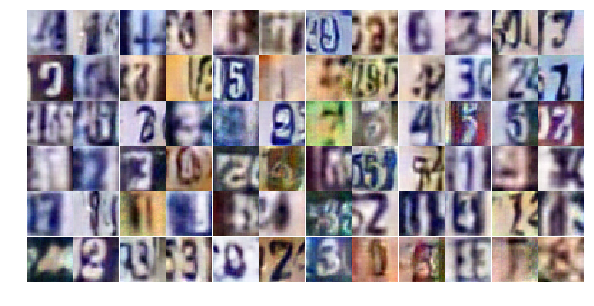

Epoch 22/25... Discriminator Loss: 0.4683... Generator Loss: 2.3442
Epoch 22/25... Discriminator Loss: 0.6431... Generator Loss: 1.5721
Epoch 22/25... Discriminator Loss: 1.5130... Generator Loss: 0.4254
Epoch 22/25... Discriminator Loss: 0.8880... Generator Loss: 0.8183
Epoch 22/25... Discriminator Loss: 1.0167... Generator Loss: 0.8811
Epoch 22/25... Discriminator Loss: 0.5896... Generator Loss: 1.5130
Epoch 22/25... Discriminator Loss: 0.6320... Generator Loss: 1.1159
Epoch 22/25... Discriminator Loss: 0.4716... Generator Loss: 1.3718
Epoch 22/25... Discriminator Loss: 1.2759... Generator Loss: 0.5324
Epoch 22/25... Discriminator Loss: 1.8194... Generator Loss: 0.2698


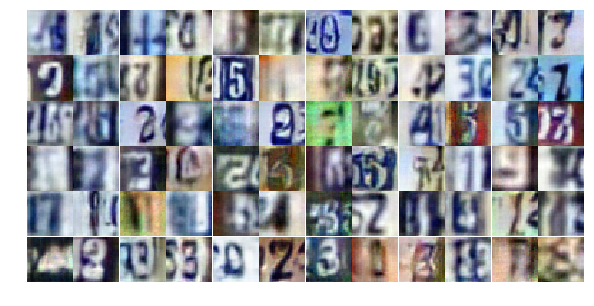

Epoch 22/25... Discriminator Loss: 0.6049... Generator Loss: 1.3282
Epoch 22/25... Discriminator Loss: 0.4923... Generator Loss: 1.6953
Epoch 22/25... Discriminator Loss: 0.7493... Generator Loss: 1.1460
Epoch 22/25... Discriminator Loss: 0.6086... Generator Loss: 1.0939
Epoch 22/25... Discriminator Loss: 0.6546... Generator Loss: 0.9877
Epoch 22/25... Discriminator Loss: 0.6097... Generator Loss: 2.3066
Epoch 22/25... Discriminator Loss: 0.4535... Generator Loss: 1.8890
Epoch 22/25... Discriminator Loss: 0.3956... Generator Loss: 1.7033
Epoch 22/25... Discriminator Loss: 0.8053... Generator Loss: 0.9000
Epoch 22/25... Discriminator Loss: 0.9364... Generator Loss: 0.6939


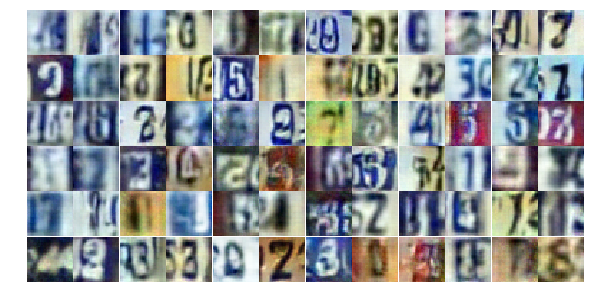

Epoch 22/25... Discriminator Loss: 0.4056... Generator Loss: 1.6721
Epoch 22/25... Discriminator Loss: 0.5872... Generator Loss: 1.1429
Epoch 22/25... Discriminator Loss: 0.9843... Generator Loss: 0.6973
Epoch 22/25... Discriminator Loss: 0.6590... Generator Loss: 1.0018
Epoch 22/25... Discriminator Loss: 0.9200... Generator Loss: 0.8089
Epoch 22/25... Discriminator Loss: 0.8086... Generator Loss: 0.8867
Epoch 22/25... Discriminator Loss: 1.8623... Generator Loss: 0.2984
Epoch 22/25... Discriminator Loss: 0.6858... Generator Loss: 2.3956
Epoch 22/25... Discriminator Loss: 1.0504... Generator Loss: 0.7980
Epoch 22/25... Discriminator Loss: 0.9871... Generator Loss: 0.6918


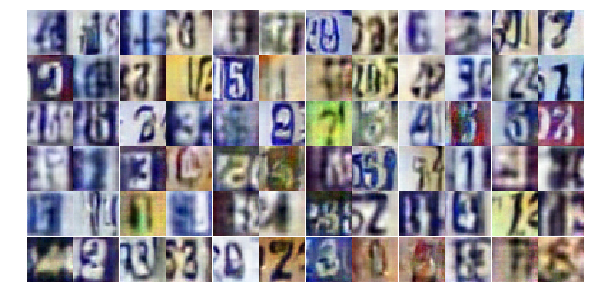

Epoch 22/25... Discriminator Loss: 0.7146... Generator Loss: 1.2190
Epoch 22/25... Discriminator Loss: 0.6435... Generator Loss: 1.0717
Epoch 22/25... Discriminator Loss: 0.3867... Generator Loss: 1.6396
Epoch 22/25... Discriminator Loss: 0.8819... Generator Loss: 0.7280
Epoch 22/25... Discriminator Loss: 0.5799... Generator Loss: 1.0667
Epoch 22/25... Discriminator Loss: 0.3922... Generator Loss: 1.5181
Epoch 22/25... Discriminator Loss: 0.5167... Generator Loss: 1.3758
Epoch 22/25... Discriminator Loss: 1.2136... Generator Loss: 0.5449
Epoch 22/25... Discriminator Loss: 1.3850... Generator Loss: 0.5351
Epoch 22/25... Discriminator Loss: 0.7936... Generator Loss: 0.9452


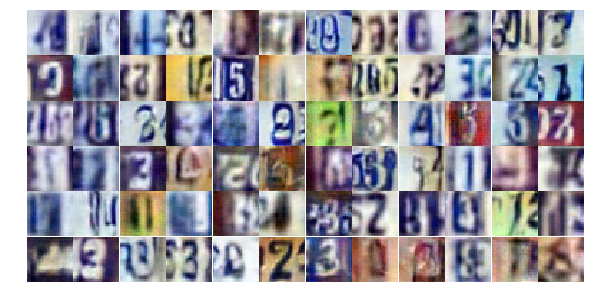

Epoch 22/25... Discriminator Loss: 1.3604... Generator Loss: 0.5070
Epoch 22/25... Discriminator Loss: 0.5098... Generator Loss: 1.4417
Epoch 22/25... Discriminator Loss: 0.7465... Generator Loss: 0.9238
Epoch 22/25... Discriminator Loss: 0.8914... Generator Loss: 0.8497
Epoch 22/25... Discriminator Loss: 0.8291... Generator Loss: 0.8613
Epoch 22/25... Discriminator Loss: 2.1668... Generator Loss: 5.1027
Epoch 22/25... Discriminator Loss: 1.0444... Generator Loss: 0.7533
Epoch 22/25... Discriminator Loss: 0.6231... Generator Loss: 1.1502
Epoch 22/25... Discriminator Loss: 0.9522... Generator Loss: 0.8518
Epoch 22/25... Discriminator Loss: 0.7839... Generator Loss: 0.9209


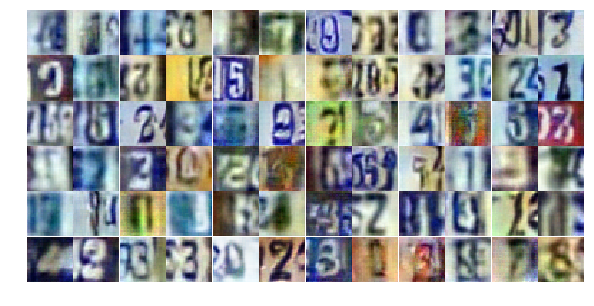

Epoch 23/25... Discriminator Loss: 0.7772... Generator Loss: 0.9609
Epoch 23/25... Discriminator Loss: 0.6670... Generator Loss: 0.9681
Epoch 23/25... Discriminator Loss: 0.7255... Generator Loss: 1.0022
Epoch 23/25... Discriminator Loss: 0.6680... Generator Loss: 1.0553
Epoch 23/25... Discriminator Loss: 0.7888... Generator Loss: 0.8783
Epoch 23/25... Discriminator Loss: 0.8002... Generator Loss: 1.3574
Epoch 23/25... Discriminator Loss: 0.7483... Generator Loss: 1.0160
Epoch 23/25... Discriminator Loss: 0.5096... Generator Loss: 1.2804
Epoch 23/25... Discriminator Loss: 0.6711... Generator Loss: 1.1315
Epoch 23/25... Discriminator Loss: 0.3717... Generator Loss: 1.7719


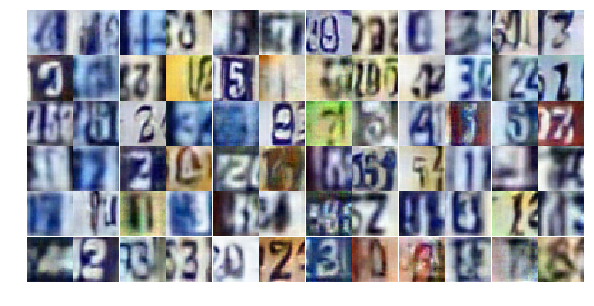

Epoch 23/25... Discriminator Loss: 0.5309... Generator Loss: 1.2346
Epoch 23/25... Discriminator Loss: 0.9530... Generator Loss: 0.6860
Epoch 23/25... Discriminator Loss: 0.9480... Generator Loss: 0.6731
Epoch 23/25... Discriminator Loss: 0.5343... Generator Loss: 1.2613
Epoch 23/25... Discriminator Loss: 0.4202... Generator Loss: 1.4028
Epoch 23/25... Discriminator Loss: 1.3343... Generator Loss: 0.4824
Epoch 23/25... Discriminator Loss: 0.7794... Generator Loss: 0.9404
Epoch 23/25... Discriminator Loss: 0.8709... Generator Loss: 0.7449
Epoch 23/25... Discriminator Loss: 1.5922... Generator Loss: 0.3880
Epoch 23/25... Discriminator Loss: 0.9140... Generator Loss: 0.8148


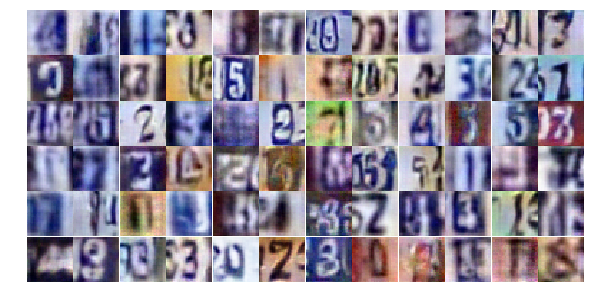

Epoch 23/25... Discriminator Loss: 1.0833... Generator Loss: 0.6174
Epoch 23/25... Discriminator Loss: 0.6073... Generator Loss: 1.1317
Epoch 23/25... Discriminator Loss: 1.2757... Generator Loss: 0.4461
Epoch 23/25... Discriminator Loss: 1.0508... Generator Loss: 0.5831
Epoch 23/25... Discriminator Loss: 0.4796... Generator Loss: 1.5848
Epoch 23/25... Discriminator Loss: 0.7454... Generator Loss: 0.9076
Epoch 23/25... Discriminator Loss: 0.6909... Generator Loss: 1.0177
Epoch 23/25... Discriminator Loss: 0.8477... Generator Loss: 0.8263
Epoch 23/25... Discriminator Loss: 0.5358... Generator Loss: 1.3450
Epoch 23/25... Discriminator Loss: 0.7807... Generator Loss: 1.5008


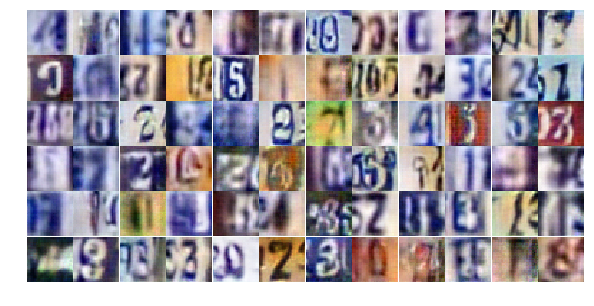

Epoch 23/25... Discriminator Loss: 0.6066... Generator Loss: 1.0597
Epoch 23/25... Discriminator Loss: 0.8121... Generator Loss: 0.9611
Epoch 23/25... Discriminator Loss: 0.7169... Generator Loss: 1.1924
Epoch 23/25... Discriminator Loss: 1.2447... Generator Loss: 0.5774
Epoch 23/25... Discriminator Loss: 0.5124... Generator Loss: 1.3932
Epoch 23/25... Discriminator Loss: 1.2995... Generator Loss: 0.5213
Epoch 23/25... Discriminator Loss: 1.6849... Generator Loss: 0.3137
Epoch 23/25... Discriminator Loss: 0.7823... Generator Loss: 0.9356
Epoch 23/25... Discriminator Loss: 0.3685... Generator Loss: 1.8858
Epoch 23/25... Discriminator Loss: 0.7480... Generator Loss: 0.8688


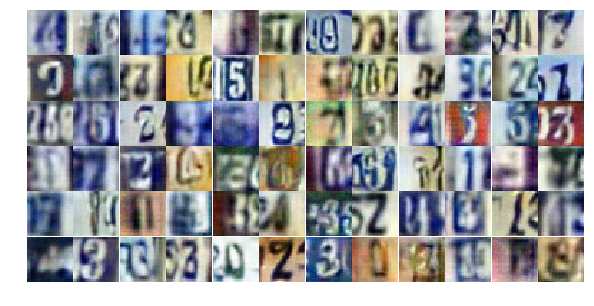

Epoch 23/25... Discriminator Loss: 0.9633... Generator Loss: 0.7462
Epoch 23/25... Discriminator Loss: 0.5091... Generator Loss: 1.7048
Epoch 23/25... Discriminator Loss: 1.0965... Generator Loss: 0.5864


In [ ]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))